In [1]:
!pip install -q pytorch-msssim

In [2]:
import os
import numpy as np

from PIL import Image
import matplotlib.pyplot as plt

import torch
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms

import torch.nn as nn
import torch.optim as optim
from torch.optim.lr_scheduler import LambdaLR
from torchvision.transforms import functional as F
import torchvision.transforms as T
import torchvision.models as models

from pytorch_msssim import ssim as ssim_fn
from pytorch_msssim import ms_ssim as ms_ssim_fn
from torchmetrics.image import PeakSignalNoiseRatio

import random

from tqdm.notebook import tqdm

In [3]:
SEED = 1834579290

np.random.seed(SEED)
random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed(SEED)
    torch.cuda.manual_seed_all(SEED)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [5]:
class Conf:
    image_dir = '/kaggle/input/xray-bone-shadow-supression/augmented/augmented'
    batch_size = 8
    image_size = 256

In [6]:
class ImageDataset(Dataset):
    def __init__(self, image_dir, set_type="train"):
        self.image_dir = image_dir
        self.x_image_dir = os.listdir(os.path.join(image_dir, 'source'))
        self.y_image_dir = os.listdir(os.path.join(image_dir, 'target'))

        self.to_tensor = T.ToTensor()

        data_len = len(self.x_image_dir)
        train_size = data_len * 0.8
        val_size = data_len * 0.15

        train_ptr = train_size
        val_ptr = train_size + val_size

        data_a, data_b = 0, 0

        if set_type == "train":
            data_a, data_b = 0, train_ptr
        elif set_type == "val":
            data_a, data_b = train_ptr, val_ptr
        else:
            data_a, data_b = val_ptr, data_len
        
        self.x_image_dir = self.x_image_dir[int(data_a):int(data_b)]
        self.y_image_dir = self.y_image_dir[int(data_a):int(data_b)]
        
    def __len__(self):
        return len(self.x_image_dir)

    def __getitem__(self, idx):
        x_img_path = os.path.join(self.image_dir, "source", self.x_image_dir[idx])
        y_img_path = os.path.join(self.image_dir, "target", self.y_image_dir[idx])
        
        x_image = Image.open(x_img_path).convert('L')
        y_image = Image.open(y_img_path).convert('L')

        x_image = x_image.resize((Conf.image_size, Conf.image_size), Image.BICUBIC)
        y_image = y_image.resize((Conf.image_size, Conf.image_size), Image.BICUBIC)

        x_tensor = self.to_tensor(x_image)
        y_tensor = self.to_tensor(y_image)

        return x_tensor, y_tensor

In [7]:
%%time

train_dataset = ImageDataset(Conf.image_dir, "train")
val_dataset = ImageDataset(Conf.image_dir, "val")
test_dataset = ImageDataset(Conf.image_dir, "test")

train_loader = DataLoader(train_dataset, batch_size = Conf.batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size = Conf.batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size = Conf.batch_size, shuffle=False)

CPU times: user 4.6 ms, sys: 4.69 ms, total: 9.3 ms
Wall time: 79.4 ms


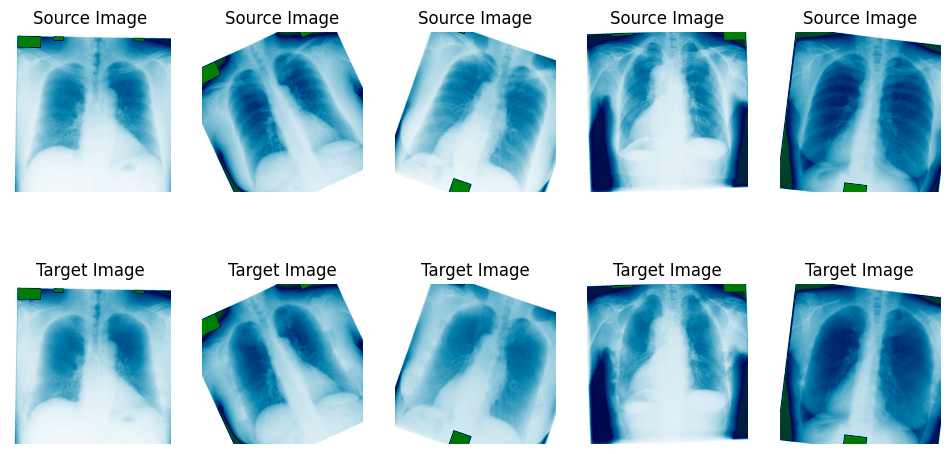

In [8]:
cmap = "ocean_r"
def display_samples(loader, num_samples=5):
    samples_displayed = 0
    plt.figure(figsize=(12, 6))
    for x, y in loader:
        for i in range(x.size(0)):
            if samples_displayed >= num_samples:
                plt.show()
                return
            
            plt.subplot(2, num_samples, samples_displayed + 1)
            plt.imshow(x[i].permute(1, 2, 0).numpy(), cmap=cmap)
            plt.title("Source Image")
            plt.axis('off')

            plt.subplot(2, num_samples, samples_displayed + 1 + num_samples)
            plt.imshow(y[i].permute(1, 2, 0).numpy(), cmap=cmap)
            plt.title("Target Image")
            plt.axis('off')
            
            samples_displayed += 1

display_samples(test_loader)

In [9]:
class Gaussian(nn.Module):
    def __init__(self):
        super(Gaussian, self).__init__()

    def forward(self, x):
        return torch.exp(-x**2)

class XUnit(nn.Module):
    def __init__(self, in_channels, kernel_size=9, g=True):
        super().__init__()
        self.depthwise = nn.Conv2d(
            in_channels, 
            in_channels, 
            kernel_size=kernel_size, 
            padding=kernel_size // 2,
            groups=in_channels, 
            bias=True
        )
        self.G = Gaussian() if g else nn.Sigmoid()

    def forward(self, x):
        out = nn.functional.relu(x)
        out = self.depthwise(out)
        out = self.G(out)
        out = out * x
        return out

class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=(3,3), stride=1, padding=1, dilation=1):
        super().__init__()
        self.conv = nn.Conv2d(
            in_channels, 
            out_channels, 
            kernel_size=kernel_size, 
            stride=stride, 
            dilation=dilation, 
            padding=dilation,
            bias=True
        )
        self.x_unit = XUnit(out_channels)

    def forward(self, x):
        x = self.conv(x)
        x = self.x_unit(x)
        return x
        
class UpBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, dilation=1):
        super().__init__()
        self.conv_block = ConvBlock(
            in_channels, 
            out_channels, 
            kernel_size=kernel_size, 
            stride=1, 
            dilation=dilation
        )

    def forward(self, x, skip):
        x = torch.cat([x, skip], dim=1)
        x = self.conv_block(x)
        return x

class EncoderBlock(nn.Module):
    def __init__(self, in_channels, out_channels, level=1):
        super().__init__()
        
        dilation_c1 = 2 if (level == 3) else 1
        dilation_c2c3 = 2**(level-1)
        dilation_bn = 2**(level+1)
        dilation_d1 = 2 if (level == 3) else 1
        
        self.c1 = ConvBlock(in_channels, out_channels, dilation=dilation_c1)
        self.c2 = ConvBlock(out_channels, out_channels, dilation=dilation_c2c3)
        self.c3 = ConvBlock(out_channels, out_channels, dilation=dilation_c2c3)
        
        self.bn = ConvBlock(out_channels, out_channels, dilation=dilation_bn)
        
        self.d3 = UpBlock(2 * out_channels, out_channels, dilation=dilation_c2c3)
        self.d2 = UpBlock(2 * out_channels, out_channels, dilation=dilation_c2c3)
        self.d1 = UpBlock(2 * out_channels, out_channels, dilation=dilation_d1)

    def forward(self, x):
        c1 = self.c1(x)
        c2 = self.c2(c1)
        c3 = self.c3(c2)
        
        bn = self.bn(c3)
        
        d3 = self.d3(bn, c3)
        d2 = self.d2(d3, c2)
        d1 = self.d1(d2, c1)
        return d1

In [10]:
class xU_NetFullSharp(nn.Module):
    def __init__(self, in_channels=1, out_channels=1):
        super().__init__()
        self.f = [8, 16, 32, 64, 128]
        
        self.encoder_1_1 = EncoderBlock(in_channels, self.f[0], level=1)
        self.encoder_2_1 = EncoderBlock(self.f[0], self.f[1], level=1)
        self.encoder_3_1 = EncoderBlock(self.f[1], self.f[2], level=2)
        self.encoder_4_1 = EncoderBlock(self.f[2], self.f[3], level=2)
        self.encoder_5_1 = EncoderBlock(self.f[3], self.f[4], level=3)
        
        self.maxpool_2x2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.maxpool_4x4 = nn.MaxPool2d(kernel_size=4, stride=4)
        self.maxpool_8x8 = nn.MaxPool2d(kernel_size=8, stride=8)

        self.conv1_2 = ConvBlock(self.f[1] + self.f[0], self.f[0])
        self.conv2_2 = ConvBlock(self.f[2] + self.f[1] + self.f[0], self.f[1])
        self.conv1_3 = ConvBlock(self.f[1] + self.f[0] * 2 + self.f[2], self.f[0])
        self.conv3_2_1 = ConvBlock(self.f[0] + self.f[1], self.f[2] * 2)
        self.conv3_2 = ConvBlock(self.f[3] + self.f[2] + self.f[2] * 2, self.f[2])
        self.conv2_3 = ConvBlock(self.f[2] + self.f[1] * 2 + self.f[3] + self.f[0], self.f[1])
        self.conv1_4_1 = ConvBlock(self.f[3] + self.f[2], self.f[0] * 2)
        self.conv1_4 = ConvBlock(self.f[1] + self.f[0] * 5, self.f[0])
        self.conv4_2_1 = ConvBlock(self.f[2] + self.f[1] + self.f[0], self.f[3] * 3)
        self.conv4_2 = ConvBlock(self.f[4] + self.f[3] * 4, self.f[3])
        self.conv3_3_1 = ConvBlock(self.f[1] + self.f[0], self.f[2] * 2)
        self.conv3_3 = ConvBlock(self.f[3] + self.f[2] * 2 + self.f[4] + self.f[2] * 2, self.f[2])
        self.conv2_4_1 = ConvBlock(self.f[3] + self.f[4], self.f[1] * 2)
        self.conv2_4 = ConvBlock(self.f[2] + self.f[1] * 5 + self.f[0], self.f[1])
        self.conv1_5_1 = ConvBlock(self.f[2] + self.f[3] + self.f[4], self.f[0] * 3)
        self.conv1_5 = ConvBlock(self.f[1] + self.f[0] * 7, self.f[0])
        
        self.up2 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        self.up4 = nn.Upsample(scale_factor=4, mode='bilinear', align_corners=False)
        self.up8 = nn.Upsample(scale_factor=8, mode='bilinear', align_corners=False)
        self.up16 = nn.Upsample(scale_factor=16, mode='bilinear', align_corners=False)
        
        self.out_conv = nn.Conv2d(self.f[0], out_channels, kernel_size=1, padding=0)

    def forward(self, x):
        conv1_1 = self.encoder_1_1(x)
        pool1_1_1 = self.maxpool_2x2(conv1_1)
        pool1_1_2 = self.maxpool_4x4(conv1_1)
        pool1_1_3 = self.maxpool_8x8(conv1_1)
        
        conv2_1 = self.encoder_2_1(pool1_1_1)
        pool2_1_1 = self.maxpool_2x2(conv2_1)
        pool2_1_2 = self.maxpool_4x4(conv2_1)
        
        up1_2 = self.up2(conv2_1)
        conv1_2_in = torch.cat([up1_2, conv1_1], dim=1)
        conv1_2 = self.conv1_2(conv1_2_in)
        pool1_2_1 = self.maxpool_2x2(conv1_2)
        pool1_2_2 = self.maxpool_4x4(conv1_2)
        
        conv3_1 = self.encoder_3_1(pool2_1_1)
        pool3 = self.maxpool_2x2(conv3_1)
        conv3_1_1_3 = self.up4(conv3_1)
        
        up2_2 = self.up2(conv3_1)
        conv2_2_in = torch.cat([up2_2, conv2_1, pool1_1_1], dim=1)
        conv2_2 = self.conv2_2(conv2_2_in)
        pool2_2_1 = self.maxpool_2x2(conv2_2)
        
        up1_3 = self.up2(conv2_2)
        conv1_3_in = torch.cat([up1_3, conv1_1, conv1_2, conv3_1_1_3], dim=1)
        conv1_3 = self.conv1_3(conv1_3_in)
        pool1_3_1 = self.maxpool_2x2(conv1_3)
            
        conv4_1 = self.encoder_4_1(pool3)
        conv4_1_2_3 = self.up4(conv4_1)
        conv4_1_1_4 = self.up8(conv4_1)
        pool4 = self.maxpool_2x2(conv4_1)
        
        up3_2 = self.up2(conv4_1)
        conv3_2_1_in = torch.cat([pool1_1_2, pool2_1_1], dim=1)
        conv3_2_1 = self.conv3_2_1(conv3_2_1_in)
        conv3_2_in = torch.cat([up3_2, conv3_1, conv3_2_1], dim=1)
        conv3_2 = self.conv3_2(conv3_2_in)

        conv3_2_1_4 = self.up4(conv3_2)

        up2_3 = self.up2(conv3_2)
        conv2_3_in = torch.cat([up2_3, conv2_1, conv2_2, conv4_1_2_3, pool1_2_1], dim=1)
        conv2_3 = self.conv2_3(conv2_3_in)
        
        up1_4 = self.up2(conv2_3)
        conv1_4_1_in = torch.cat([conv4_1_1_4, conv3_2_1_4], dim=1)
        conv1_4_1 = self.conv1_4_1(conv1_4_1_in)
        conv1_4_in = torch.cat([up1_4, conv1_1, conv1_2, conv1_3, conv1_4_1], dim=1)
        conv1_4 = self.conv1_4(conv1_4_in)
        
        conv5_1 = self.encoder_5_1(pool4)
        conv5_1_3_3 = self.up4(conv5_1)
        conv5_1_2_4 = self.up8(conv5_1)
        conv5_1_1_5 = self.up16(conv5_1)

        up4_2 = self.up2(conv5_1)
        conv4_2_1_in = torch.cat([pool3, pool2_1_2, pool1_1_3], dim=1)
        conv4_2_1 = self.conv4_2_1(conv4_2_1_in)
        conv4_2_in = torch.cat([up4_2, conv4_1, conv4_2_1], dim=1)
        conv4_2 = self.conv4_2(conv4_2_in)
        
        conv4_2_2_4 = self.up4(conv4_2)
        conv4_2_1_5 = self.up8(conv4_2)

        up3_3 = self.up2(conv4_2)
        conv3_3_1_in = torch.cat([pool2_2_1, pool1_2_2], dim=1)
        conv3_3_1 = self.conv3_3_1(conv3_3_1_in)
        conv3_3_in = torch.cat([up3_3, conv3_1, conv3_2, conv5_1_3_3, conv3_3_1], dim=1)
        conv3_3 = self.conv3_3(conv3_3_in)
        
        conv3_3_1_5 = self.up4(conv3_3)

        up2_4 = self.up2(conv3_3)
        conv2_4_1_in = torch.cat([conv4_2_2_4, conv5_1_2_4], dim=1)
        conv2_4_1 = self.conv2_4_1(conv2_4_1_in)
        conv2_4_in = torch.cat([up2_4, conv2_1, conv2_2, conv2_3, conv2_4_1, pool1_3_1], dim=1)
        conv2_4 = self.conv2_4(conv2_4_in)
        
        up1_5 = self.up2(conv2_4)
        conv1_5_1_in = torch.cat([conv3_3_1_5, conv4_2_1_5, conv5_1_1_5], dim=1)
        conv1_5_1 = self.conv1_5_1(conv1_5_1_in)
        conv1_5_in = torch.cat([up1_5, conv1_1, conv1_2, conv1_3, conv1_4, conv1_5_1], dim=1)
        conv1_5 = self.conv1_5(conv1_5_in)
        
        out = torch.sigmoid(self.out_conv(conv1_5))
        return out
        

In [11]:
_psnr = PeakSignalNoiseRatio(data_range=1.0).to(device)

def mae(y_true, y_pred):
    return nn.functional.l1_loss(y_pred, y_true, reduction='mean')

def mse(y_true, y_pred):
    return nn.functional.mse_loss(y_pred, y_true, reduction='mean')

def psnr(y_true, y_pred):
    return _psnr(y_pred, y_true)

def ssim(y_true, y_pred):
    return ssim_fn(y_pred, y_true, data_range=1.0, size_average=True)

def ssim_loss(y_true, y_pred):
    return 1.0 - ssim_fn(y_pred, y_true, data_range=1.0, size_average=True)

def l1_ssim(y_true, y_pred):
    alpha = 0.84
    delta = 1.0 - alpha
    ssim_val = 1.0 - ssim_fn(y_pred, y_true, data_range=1.0, size_average=True)
    ssim_val *= alpha
    l1_val = mae(y_pred, y_true) * delta
    return ssim_val + l1_val

def ms_ssim(y_true, y_pred):
    return ms_ssim_fn(y_pred, y_true, data_range=1.0, size_average=True)

In [12]:
class EarlyStopping:
    def __init__(self, tolerance=10, min_delta=0.01):
        self.tolerance = tolerance
        self.min_delta = min_delta
        self.min_loss = float('inf')
        self.counter = 0
        self.early_stop = False
        self.epoch = -1
        
    def __call__(self, val_loss, model, optim, epoch):
        if (self.min_loss - val_loss) > self.min_delta:
            self.counter = 0
            self.min_loss = val_loss
            self.epoch = epoch
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
            }, "best_checkpoint.pt")

        else:
            self.counter += 1
            if self.counter > self.tolerance:
                self.early_stop = True

In [13]:
early_stopper = EarlyStopping(tolerance=6, min_delta=0.00001)

In [14]:
def evaluate(loader, model, device):
    model.eval()
    metrics = {"l1_ssim": 0, "ms_ssim": 0, "ssim": 0, "mse": 0, "mae": 0, "psnr": 0}
    with torch.no_grad():
        for inputs, targets in tqdm(loader):
            inputs, targets = inputs.to(device), targets.to(device)
            outputs = model(inputs)

            metrics["l1_ssim"] += l1_ssim(targets, outputs).item()
            metrics["ms_ssim"] += ms_ssim_fn(outputs, targets, data_range=1.0, size_average=True).item()
            metrics["ssim"] += ssim_fn(outputs, targets, data_range=1.0, size_average=True).item()
            metrics["mse"] += mse(targets, outputs).item()
            metrics["mae"] += mae(targets, outputs).item()
            metrics["psnr"] += psnr(targets, outputs).item()

    for key in metrics:
        metrics[key] /= len(loader)

    return metrics

def visualize_example(test_loader, model, device, full_batch=False):
    model.eval()
    with torch.no_grad():
        for inputs, targets in test_loader:
            inputs, targets = inputs.to(device), targets.to(device)
            outputs = model(inputs)

            for i in range(inputs.shape[0] if full_batch else 1):
                input_image = inputs[i].cpu().permute(1, 2, 0)
                generated_image = outputs[i].cpu().permute(1, 2, 0)
                target_image = targets[i].cpu().permute(1, 2, 0)
    
                fig, ax = plt.subplots(1, 3, figsize=(15, 5))
                ax[0].imshow(input_image, cmap=cmap)
                ax[0].set_title("Input Image")
                ax[1].imshow(generated_image, cmap=cmap)
                ax[1].set_title("Generated Image")
                ax[2].imshow(target_image, cmap=cmap)
                ax[2].set_title("Target Image")
    
                plt.show()
            break

def display_metrics(metrics, data_subset="Validation"):
    print(f"  {data_subset} Metrics\n\tL1 SSIM: {metrics['l1_ssim']:.4f} | MS SSIM: {metrics['ms_ssim']:.4f} | SSIM: {metrics['ssim']:.4f} |\n\tMSE: {metrics['mse']:.4f} | MAE: {metrics['mae']:.4f} | PSNR: {metrics['psnr']:.4f} |")

In [15]:
def train_model(model, train_loader, val_loader, test_loader, optimizer, device, epochs, decay):
    lambda_lr = lambda epoch: 1 / (1 + decay * epoch)
    scheduler = LambdaLR(optimizer, lr_lambda=lambda_lr)
    
    model = model.to(device)
    for epoch in range(epochs):
        model.train()
        train_loss = 0
        for inputs, targets in tqdm(train_loader):
            inputs, targets = inputs.to(device), targets.to(device)
            optimizer.zero_grad()

            outputs = model(inputs)
            loss = l1_ssim(targets, outputs)
            loss.backward()
            optimizer.step()

            train_loss += loss.item()

        train_loss /= len(train_loader)

        val_metrics = evaluate(val_loader, model, device)

        print(f"Epoch {epoch+1}/{epochs}")
        print(f"  Train\n\tL1 SSIM: {train_loss:.4f}")
        display_metrics(val_metrics)
        print(f"LR: {scheduler.get_last_lr()[0]}")
        
        scheduler.step()

        visualize_example(test_loader, model, device)

        early_stopper(val_metrics["l1_ssim"], model, optimizer, epoch)
        if early_stopper.early_stop:
            print(f"Early stopping at epoch {epoch+1} (no improvement for {early_stopper.tolerance} checks).")
            break

In [16]:
model = xU_NetFullSharp().to(device)

initial_lr = 0.0001
epochs = 64
decay = initial_lr / epochs

optimizer = optim.Adam(model.parameters(), lr=initial_lr)

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 1/64
  Train
	L1 SSIM: 0.1381
  Validation Metrics
	L1 SSIM: 0.0623 | MS SSIM: 0.9757 | SSIM: 0.9306 |
	MSE: 0.0017 | MAE: 0.0245 | PSNR: 27.7294 |
LR: 0.0001


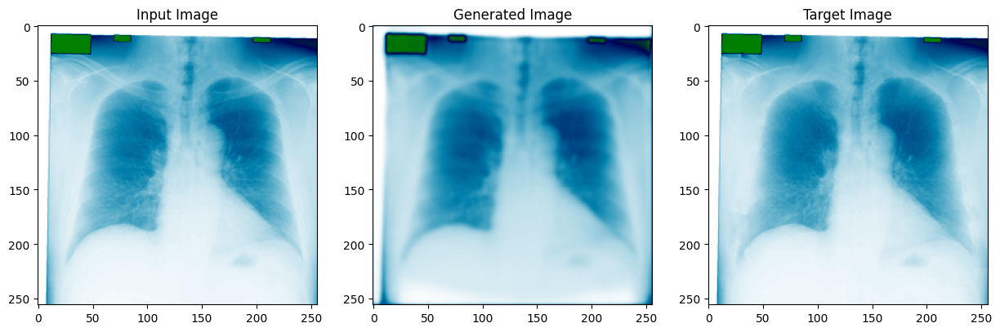

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 2/64
  Train
	L1 SSIM: 0.0539
  Validation Metrics
	L1 SSIM: 0.0487 | MS SSIM: 0.9808 | SSIM: 0.9460 |
	MSE: 0.0013 | MAE: 0.0212 | PSNR: 28.8876 |
LR: 9.999984375024414e-05


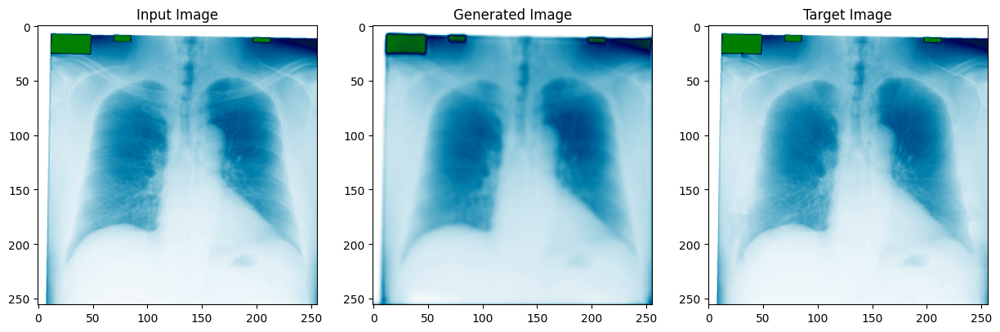

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 3/64
  Train
	L1 SSIM: 0.0461
  Validation Metrics
	L1 SSIM: 0.0453 | MS SSIM: 0.9810 | SSIM: 0.9505 |
	MSE: 0.0014 | MAE: 0.0229 | PSNR: 28.7402 |
LR: 9.999968750097656e-05


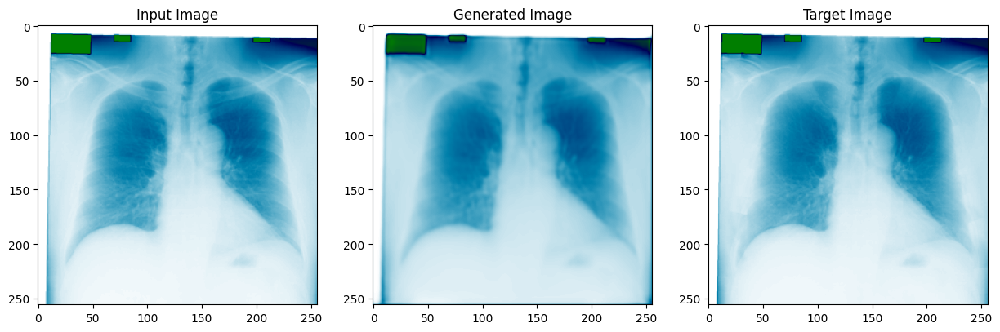

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 4/64
  Train
	L1 SSIM: 0.0427
  Validation Metrics
	L1 SSIM: 0.0429 | MS SSIM: 0.9830 | SSIM: 0.9533 |
	MSE: 0.0012 | MAE: 0.0228 | PSNR: 29.3729 |
LR: 9.999953125219727e-05


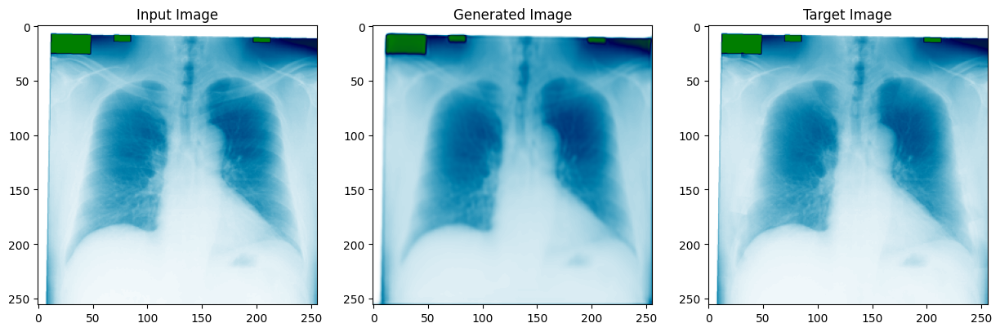

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 5/64
  Train
	L1 SSIM: 0.0401
  Validation Metrics
	L1 SSIM: 0.0388 | MS SSIM: 0.9843 | SSIM: 0.9573 |
	MSE: 0.0010 | MAE: 0.0187 | PSNR: 30.0948 |
LR: 9.999937500390624e-05


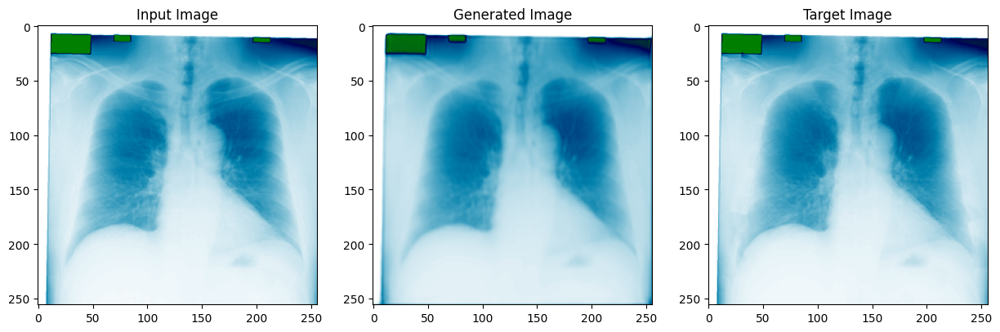

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 6/64
  Train
	L1 SSIM: 0.0385
  Validation Metrics
	L1 SSIM: 0.0415 | MS SSIM: 0.9836 | SSIM: 0.9550 |
	MSE: 0.0013 | MAE: 0.0231 | PSNR: 29.0990 |
LR: 9.999921875610347e-05


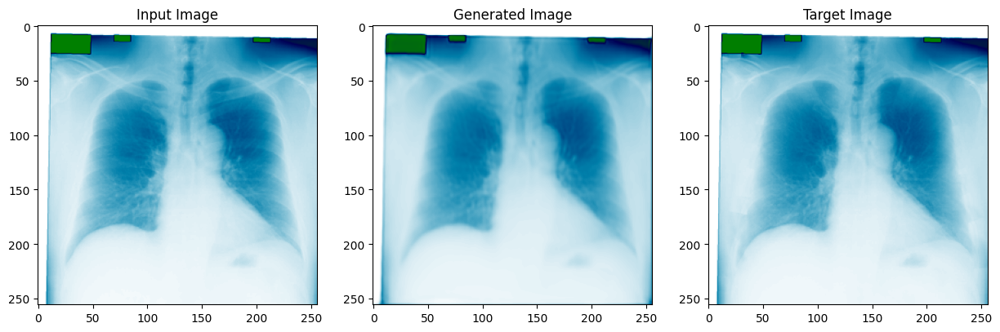

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 7/64
  Train
	L1 SSIM: 0.0372
  Validation Metrics
	L1 SSIM: 0.0401 | MS SSIM: 0.9847 | SSIM: 0.9565 |
	MSE: 0.0012 | MAE: 0.0220 | PSNR: 29.5679 |
LR: 9.999906250878897e-05


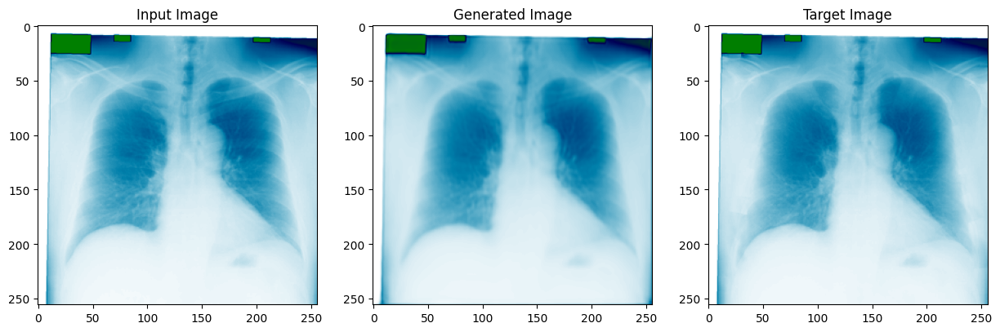

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 8/64
  Train
	L1 SSIM: 0.0359
  Validation Metrics
	L1 SSIM: 0.0356 | MS SSIM: 0.9856 | SSIM: 0.9610 |
	MSE: 0.0009 | MAE: 0.0182 | PSNR: 30.5132 |
LR: 9.999890626196277e-05


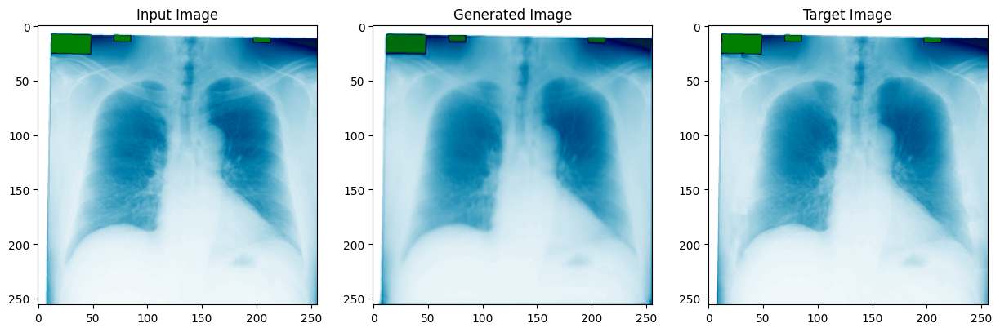

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 9/64
  Train
	L1 SSIM: 0.0349
  Validation Metrics
	L1 SSIM: 0.0354 | MS SSIM: 0.9855 | SSIM: 0.9617 |
	MSE: 0.0010 | MAE: 0.0200 | PSNR: 30.2045 |
LR: 9.999875001562482e-05


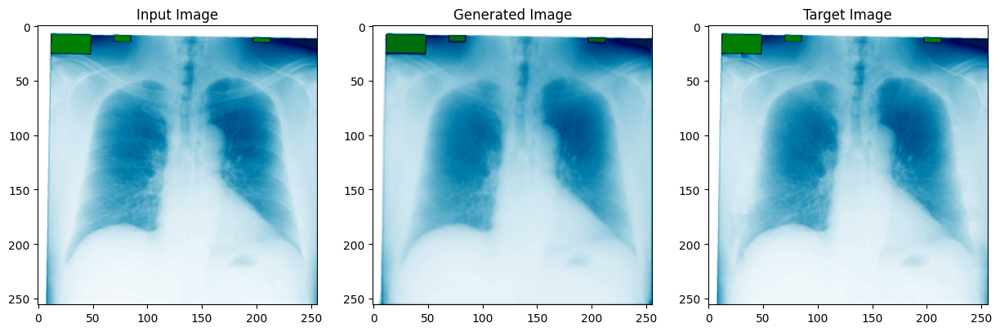

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 10/64
  Train
	L1 SSIM: 0.0338
  Validation Metrics
	L1 SSIM: 0.0336 | MS SSIM: 0.9865 | SSIM: 0.9633 |
	MSE: 0.0009 | MAE: 0.0176 | PSNR: 30.9481 |
LR: 9.999859376977512e-05


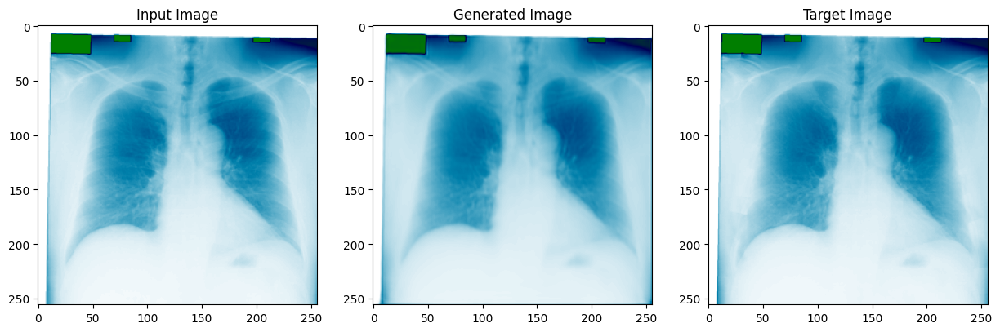

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 11/64
  Train
	L1 SSIM: 0.0330
  Validation Metrics
	L1 SSIM: 0.0330 | MS SSIM: 0.9867 | SSIM: 0.9641 |
	MSE: 0.0008 | MAE: 0.0175 | PSNR: 31.0317 |
LR: 9.999843752441369e-05


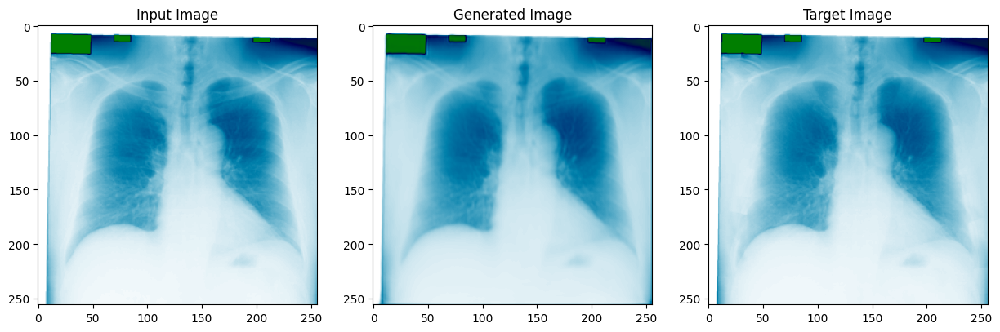

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 12/64
  Train
	L1 SSIM: 0.0325
  Validation Metrics
	L1 SSIM: 0.0327 | MS SSIM: 0.9868 | SSIM: 0.9645 |
	MSE: 0.0009 | MAE: 0.0183 | PSNR: 30.8361 |
LR: 9.999828127954051e-05


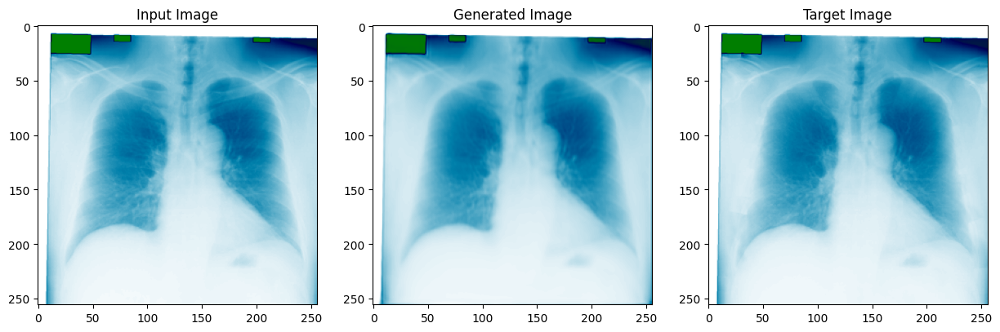

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 13/64
  Train
	L1 SSIM: 0.0316
  Validation Metrics
	L1 SSIM: 0.0317 | MS SSIM: 0.9874 | SSIM: 0.9656 |
	MSE: 0.0008 | MAE: 0.0176 | PSNR: 31.2325 |
LR: 9.99981250351556e-05


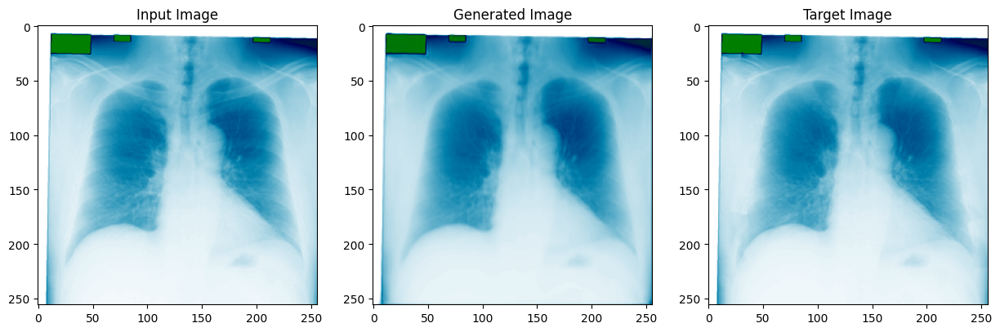

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 14/64
  Train
	L1 SSIM: 0.0308
  Validation Metrics
	L1 SSIM: 0.0327 | MS SSIM: 0.9872 | SSIM: 0.9643 |
	MSE: 0.0008 | MAE: 0.0171 | PSNR: 31.2232 |
LR: 9.999796879125894e-05


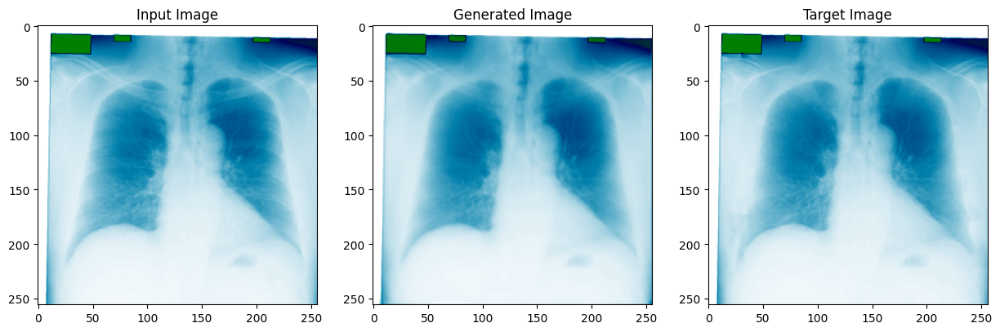

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 15/64
  Train
	L1 SSIM: 0.0301
  Validation Metrics
	L1 SSIM: 0.0327 | MS SSIM: 0.9869 | SSIM: 0.9647 |
	MSE: 0.0009 | MAE: 0.0192 | PSNR: 30.9266 |
LR: 9.999781254785051e-05


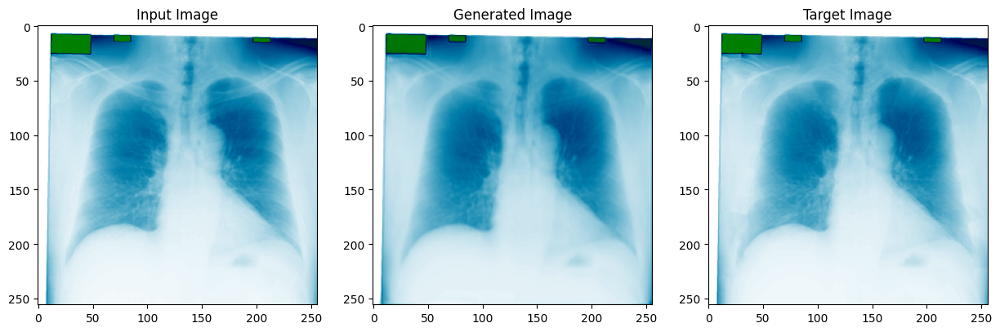

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 16/64
  Train
	L1 SSIM: 0.0291
  Validation Metrics
	L1 SSIM: 0.0287 | MS SSIM: 0.9884 | SSIM: 0.9688 |
	MSE: 0.0007 | MAE: 0.0156 | PSNR: 31.7852 |
LR: 9.999765630493036e-05


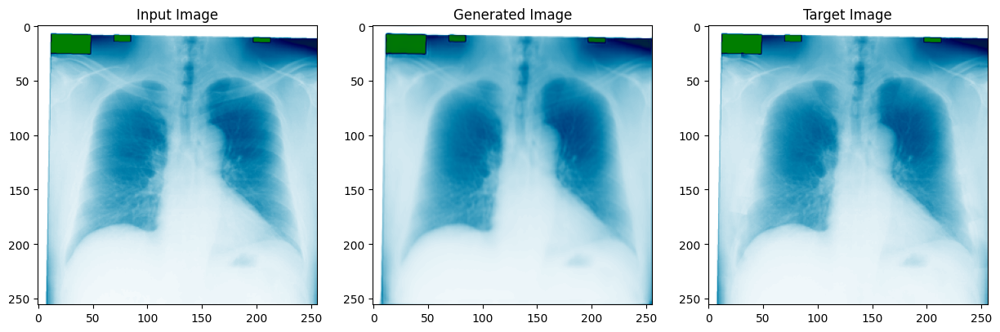

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 17/64
  Train
	L1 SSIM: 0.0285
  Validation Metrics
	L1 SSIM: 0.0283 | MS SSIM: 0.9885 | SSIM: 0.9693 |
	MSE: 0.0007 | MAE: 0.0160 | PSNR: 31.8367 |
LR: 9.999750006249845e-05


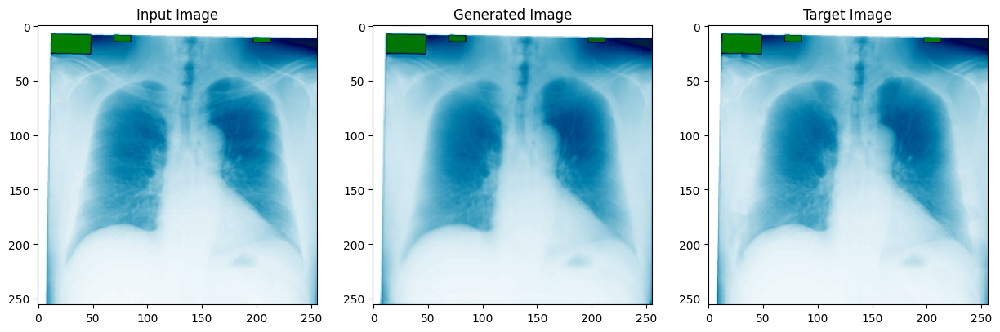

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 18/64
  Train
	L1 SSIM: 0.0273
  Validation Metrics
	L1 SSIM: 0.0284 | MS SSIM: 0.9883 | SSIM: 0.9693 |
	MSE: 0.0007 | MAE: 0.0161 | PSNR: 31.7721 |
LR: 9.999734382055476e-05


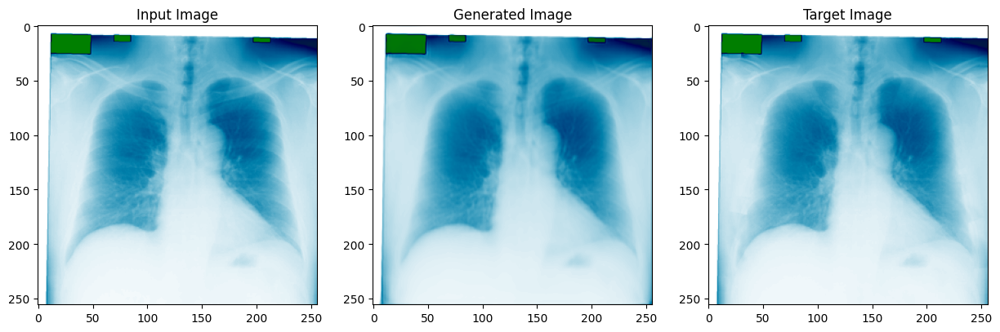

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 19/64
  Train
	L1 SSIM: 0.0268
  Validation Metrics
	L1 SSIM: 0.0277 | MS SSIM: 0.9885 | SSIM: 0.9700 |
	MSE: 0.0007 | MAE: 0.0155 | PSNR: 32.0327 |
LR: 9.999718757909933e-05


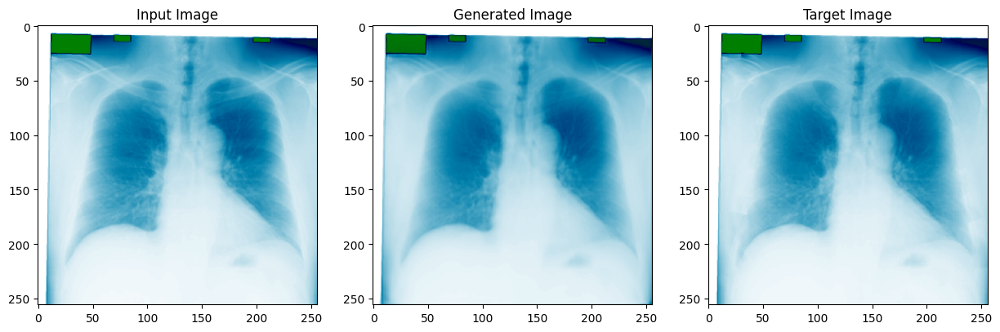

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 20/64
  Train
	L1 SSIM: 0.0261
  Validation Metrics
	L1 SSIM: 0.0269 | MS SSIM: 0.9878 | SSIM: 0.9709 |
	MSE: 0.0007 | MAE: 0.0154 | PSNR: 31.9331 |
LR: 9.999703133813215e-05


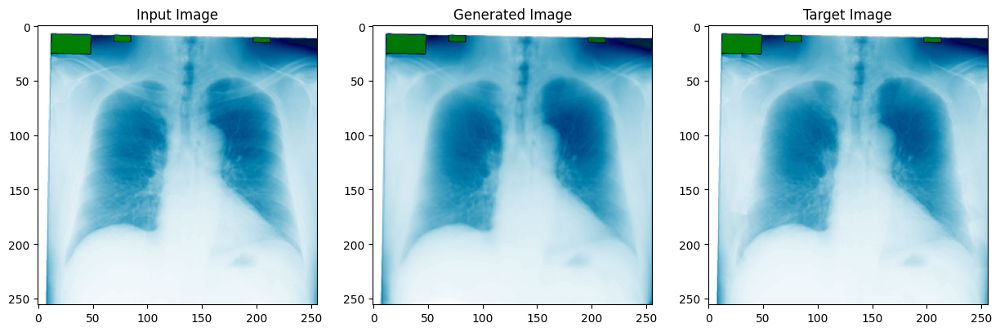

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 21/64
  Train
	L1 SSIM: 0.0250
  Validation Metrics
	L1 SSIM: 0.0256 | MS SSIM: 0.9888 | SSIM: 0.9725 |
	MSE: 0.0007 | MAE: 0.0155 | PSNR: 32.2170 |
LR: 9.99968750976532e-05


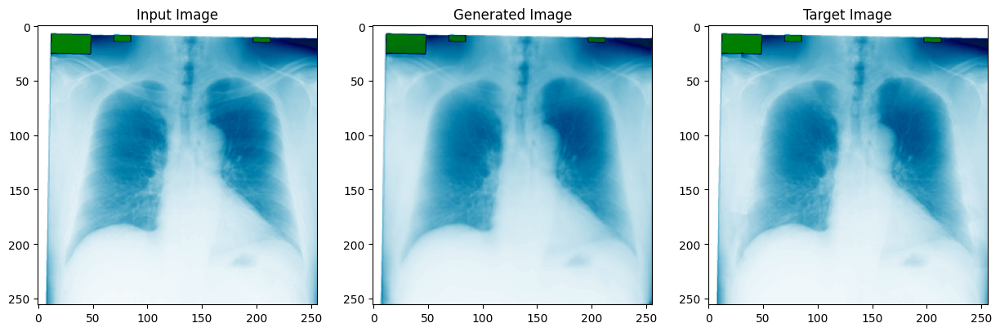

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 22/64
  Train
	L1 SSIM: 0.0243
  Validation Metrics
	L1 SSIM: 0.0247 | MS SSIM: 0.9887 | SSIM: 0.9734 |
	MSE: 0.0006 | MAE: 0.0150 | PSNR: 32.3265 |
LR: 9.999671885766248e-05


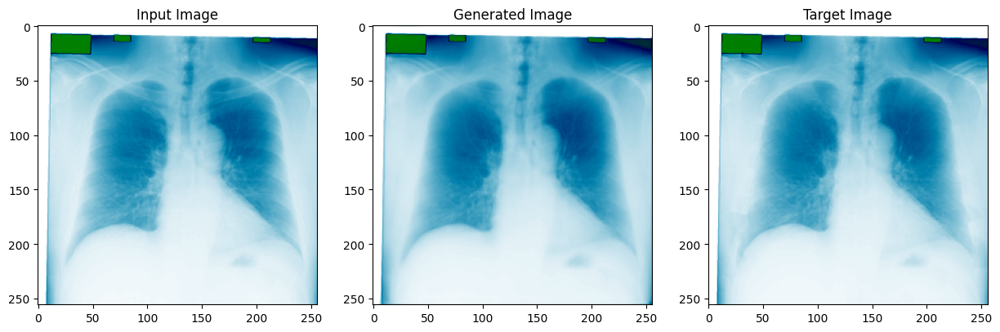

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 23/64
  Train
	L1 SSIM: 0.0238
  Validation Metrics
	L1 SSIM: 0.0251 | MS SSIM: 0.9892 | SSIM: 0.9729 |
	MSE: 0.0006 | MAE: 0.0148 | PSNR: 32.3368 |
LR: 9.999656261816001e-05


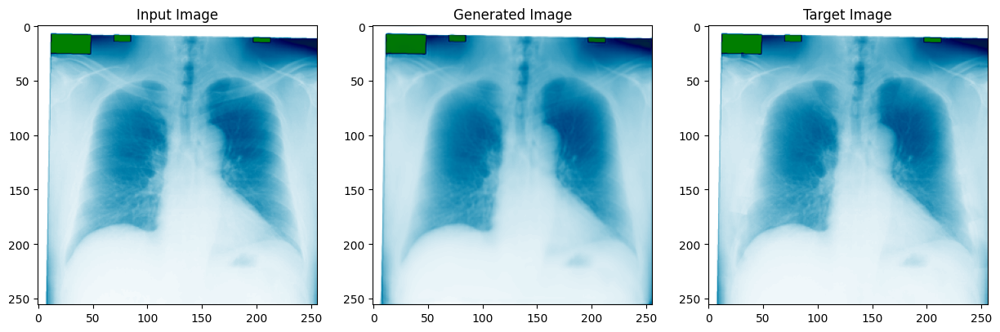

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 24/64
  Train
	L1 SSIM: 0.0228
  Validation Metrics
	L1 SSIM: 0.0243 | MS SSIM: 0.9891 | SSIM: 0.9739 |
	MSE: 0.0006 | MAE: 0.0146 | PSNR: 32.5800 |
LR: 9.999640637914574e-05


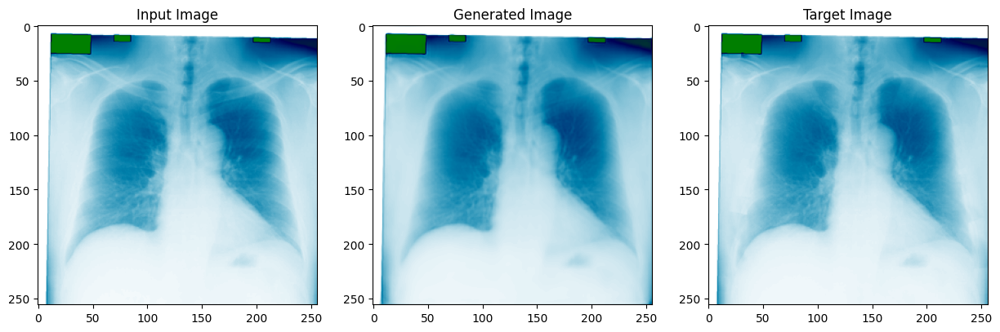

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 25/64
  Train
	L1 SSIM: 0.0223
  Validation Metrics
	L1 SSIM: 0.0225 | MS SSIM: 0.9893 | SSIM: 0.9759 |
	MSE: 0.0006 | MAE: 0.0145 | PSNR: 32.5316 |
LR: 9.999625014061973e-05


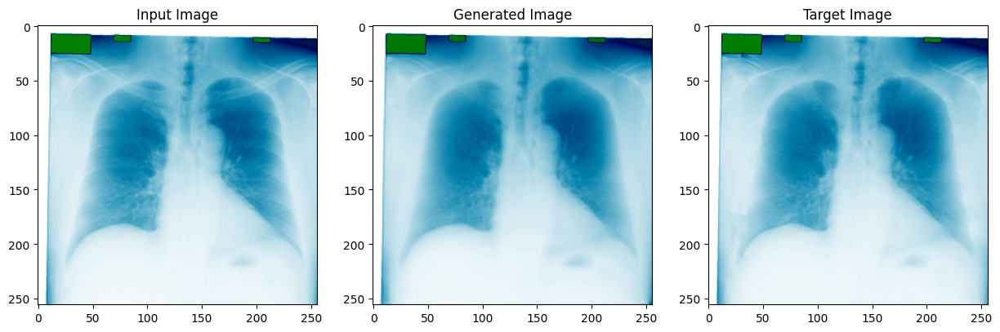

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 26/64
  Train
	L1 SSIM: 0.0216
  Validation Metrics
	L1 SSIM: 0.0219 | MS SSIM: 0.9896 | SSIM: 0.9765 |
	MSE: 0.0006 | MAE: 0.0132 | PSNR: 32.9166 |
LR: 9.999609390258193e-05


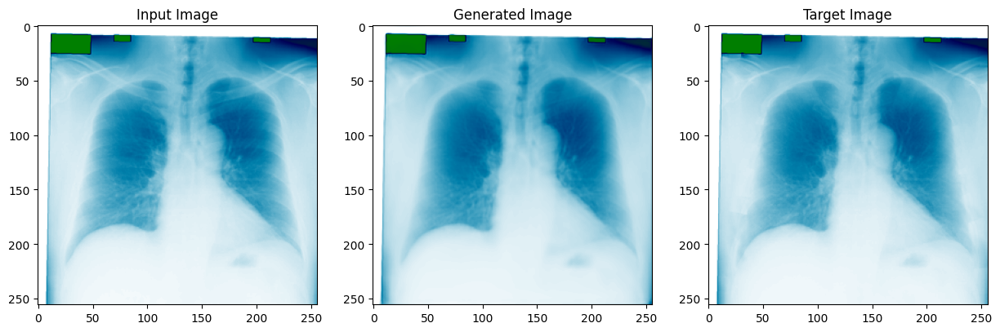

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 27/64
  Train
	L1 SSIM: 0.0208
  Validation Metrics
	L1 SSIM: 0.0210 | MS SSIM: 0.9899 | SSIM: 0.9775 |
	MSE: 0.0005 | MAE: 0.0128 | PSNR: 33.2501 |
LR: 9.999593766503236e-05


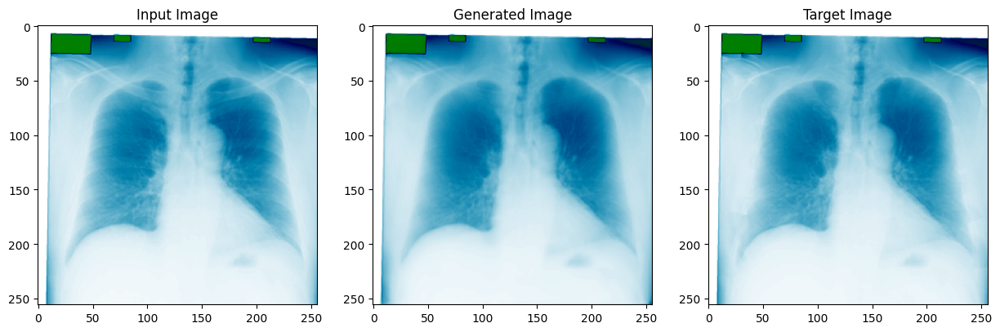

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 28/64
  Train
	L1 SSIM: 0.0200
  Validation Metrics
	L1 SSIM: 0.0207 | MS SSIM: 0.9899 | SSIM: 0.9778 |
	MSE: 0.0005 | MAE: 0.0132 | PSNR: 33.1339 |
LR: 9.9995781427971e-05


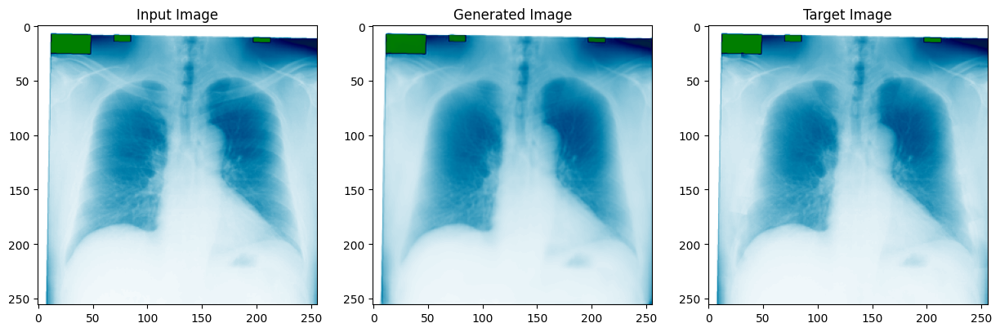

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 29/64
  Train
	L1 SSIM: 0.0193
  Validation Metrics
	L1 SSIM: 0.0207 | MS SSIM: 0.9902 | SSIM: 0.9778 |
	MSE: 0.0005 | MAE: 0.0131 | PSNR: 33.3989 |
LR: 9.999562519139789e-05


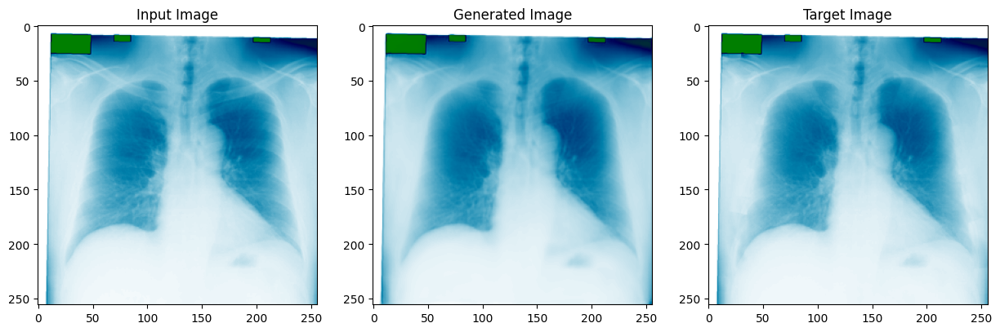

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 30/64
  Train
	L1 SSIM: 0.0189
  Validation Metrics
	L1 SSIM: 0.0199 | MS SSIM: 0.9904 | SSIM: 0.9786 |
	MSE: 0.0005 | MAE: 0.0119 | PSNR: 33.6940 |
LR: 9.999546895531297e-05


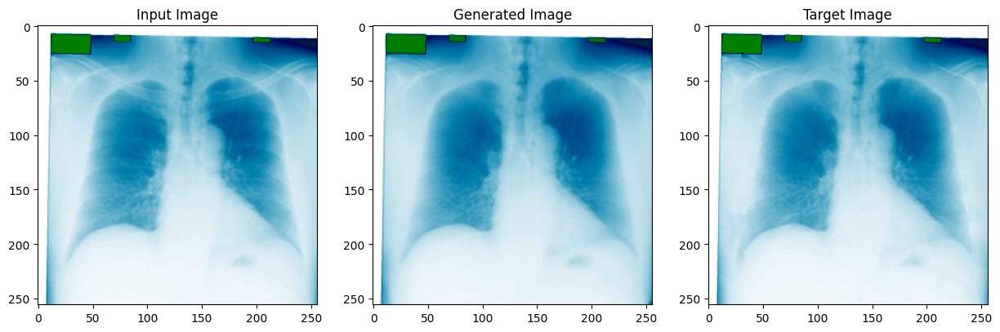

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 31/64
  Train
	L1 SSIM: 0.0185
  Validation Metrics
	L1 SSIM: 0.0194 | MS SSIM: 0.9905 | SSIM: 0.9791 |
	MSE: 0.0005 | MAE: 0.0117 | PSNR: 33.7244 |
LR: 9.999531271971627e-05


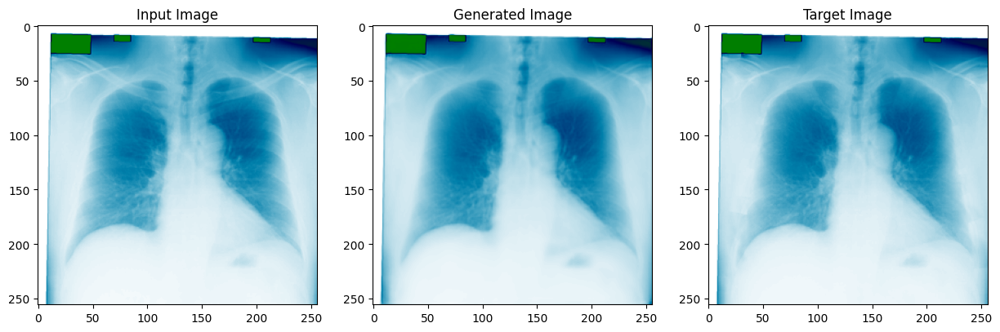

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 32/64
  Train
	L1 SSIM: 0.0173
  Validation Metrics
	L1 SSIM: 0.0186 | MS SSIM: 0.9907 | SSIM: 0.9800 |
	MSE: 0.0005 | MAE: 0.0111 | PSNR: 33.8886 |
LR: 9.999515648460778e-05


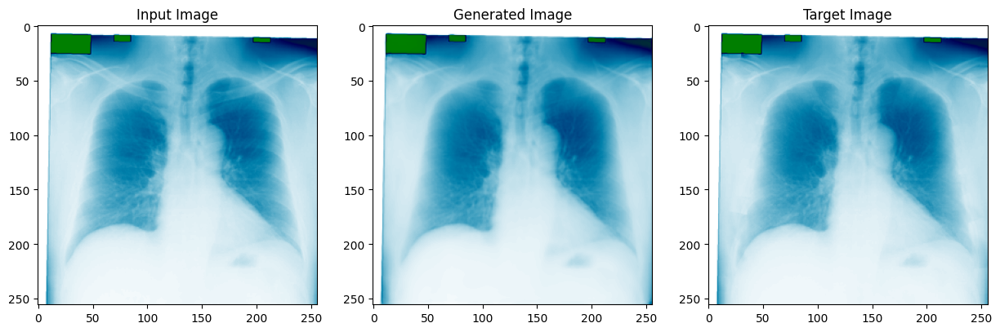

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 33/64
  Train
	L1 SSIM: 0.0172
  Validation Metrics
	L1 SSIM: 0.0184 | MS SSIM: 0.9910 | SSIM: 0.9803 |
	MSE: 0.0004 | MAE: 0.0114 | PSNR: 33.9280 |
LR: 9.99950002499875e-05


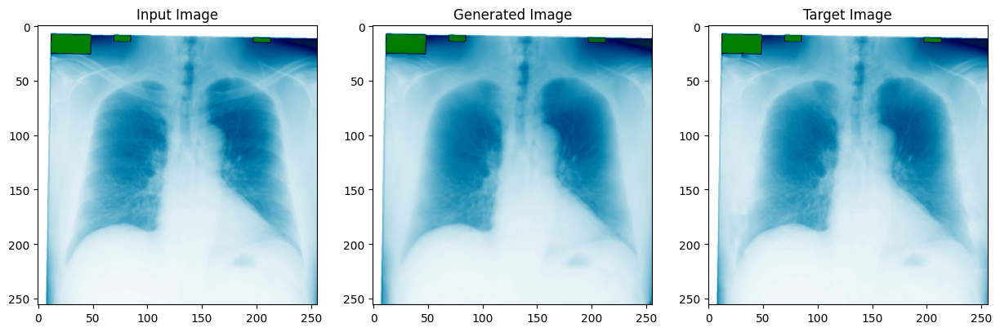

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 34/64
  Train
	L1 SSIM: 0.0168
  Validation Metrics
	L1 SSIM: 0.0181 | MS SSIM: 0.9912 | SSIM: 0.9805 |
	MSE: 0.0004 | MAE: 0.0108 | PSNR: 34.1456 |
LR: 9.999484401585545e-05


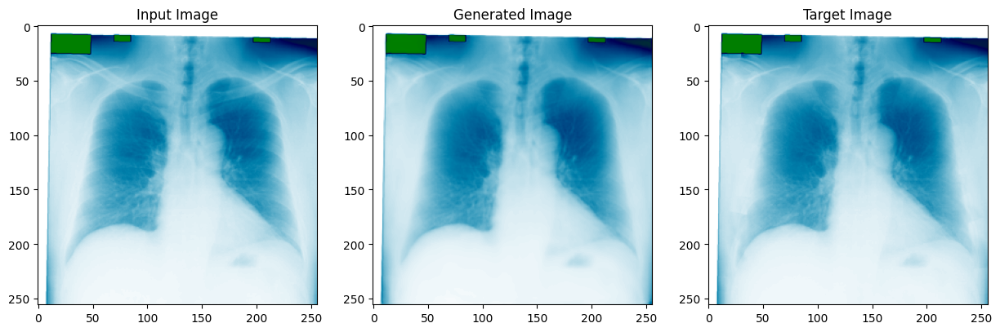

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 35/64
  Train
	L1 SSIM: 0.0162
  Validation Metrics
	L1 SSIM: 0.0172 | MS SSIM: 0.9910 | SSIM: 0.9816 |
	MSE: 0.0004 | MAE: 0.0109 | PSNR: 34.2667 |
LR: 9.999468778221157e-05


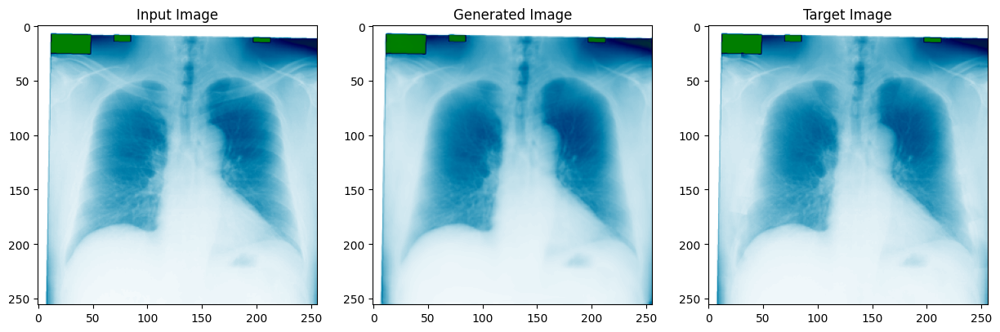

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 36/64
  Train
	L1 SSIM: 0.0158
  Validation Metrics
	L1 SSIM: 0.0171 | MS SSIM: 0.9914 | SSIM: 0.9816 |
	MSE: 0.0004 | MAE: 0.0101 | PSNR: 34.4374 |
LR: 9.999453154905592e-05


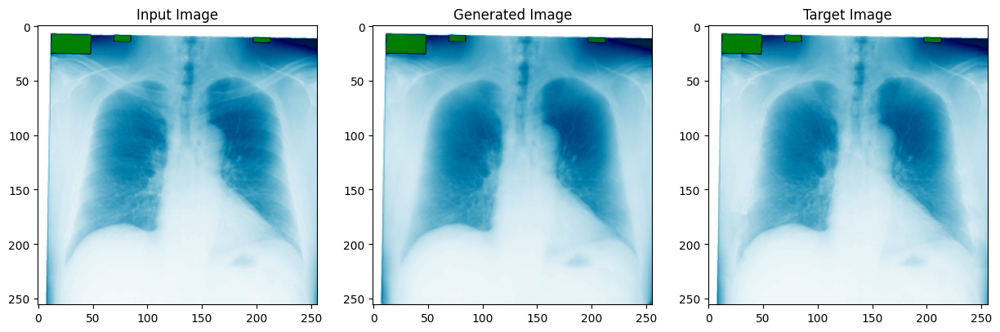

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 37/64
  Train
	L1 SSIM: 0.0157
  Validation Metrics
	L1 SSIM: 0.0160 | MS SSIM: 0.9919 | SSIM: 0.9828 |
	MSE: 0.0004 | MAE: 0.0094 | PSNR: 34.9063 |
LR: 9.999437531638845e-05


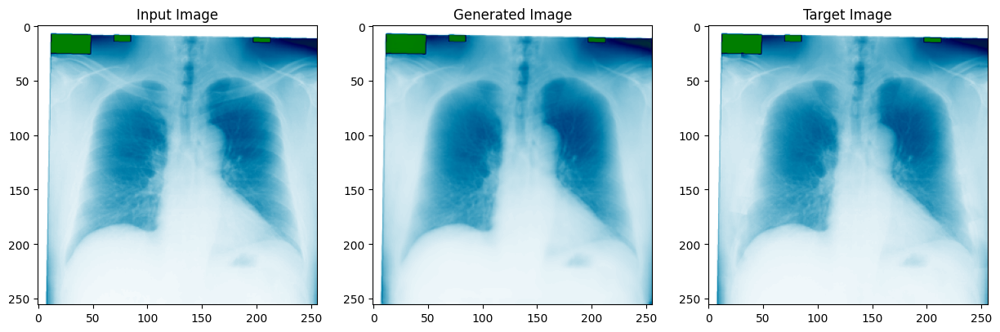

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 38/64
  Train
	L1 SSIM: 0.0148
  Validation Metrics
	L1 SSIM: 0.0160 | MS SSIM: 0.9919 | SSIM: 0.9827 |
	MSE: 0.0004 | MAE: 0.0095 | PSNR: 34.8891 |
LR: 9.999421908420921e-05


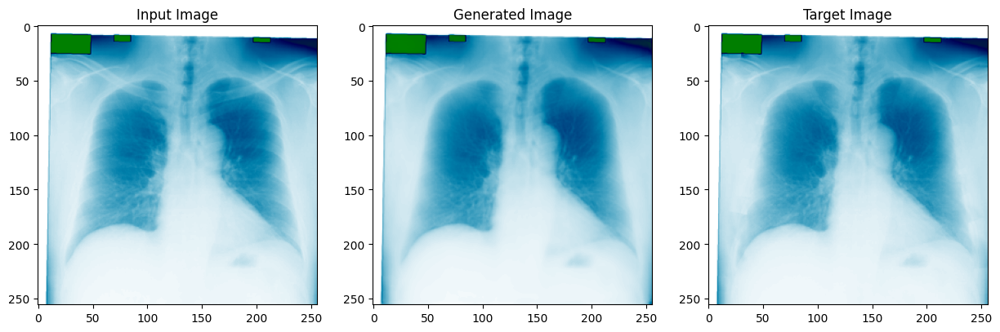

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 39/64
  Train
	L1 SSIM: 0.0154
  Validation Metrics
	L1 SSIM: 0.0158 | MS SSIM: 0.9919 | SSIM: 0.9829 |
	MSE: 0.0004 | MAE: 0.0092 | PSNR: 35.0626 |
LR: 9.999406285251814e-05


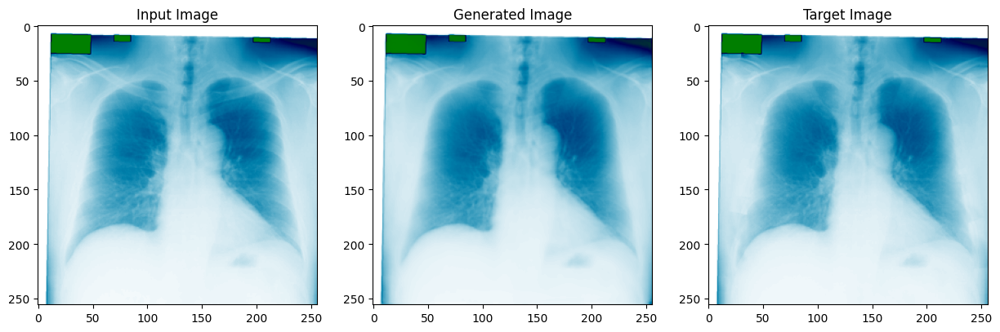

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 40/64
  Train
	L1 SSIM: 0.0143
  Validation Metrics
	L1 SSIM: 0.0152 | MS SSIM: 0.9922 | SSIM: 0.9836 |
	MSE: 0.0003 | MAE: 0.0088 | PSNR: 35.2206 |
LR: 9.999390662131527e-05


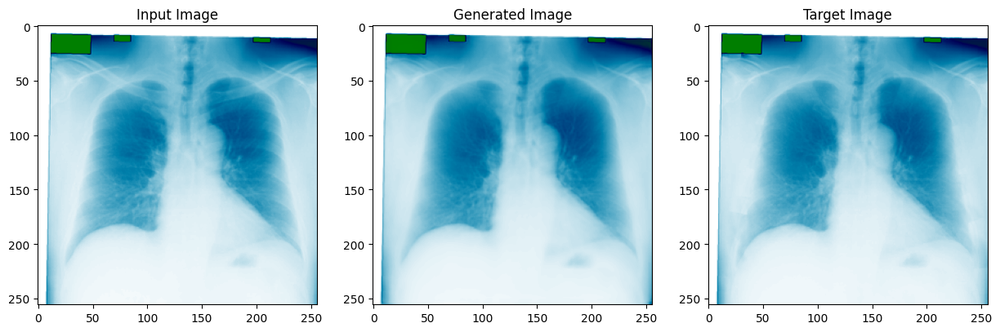

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 41/64
  Train
	L1 SSIM: 0.0140
  Validation Metrics
	L1 SSIM: 0.0154 | MS SSIM: 0.9920 | SSIM: 0.9834 |
	MSE: 0.0004 | MAE: 0.0091 | PSNR: 35.0997 |
LR: 9.999375039060058e-05


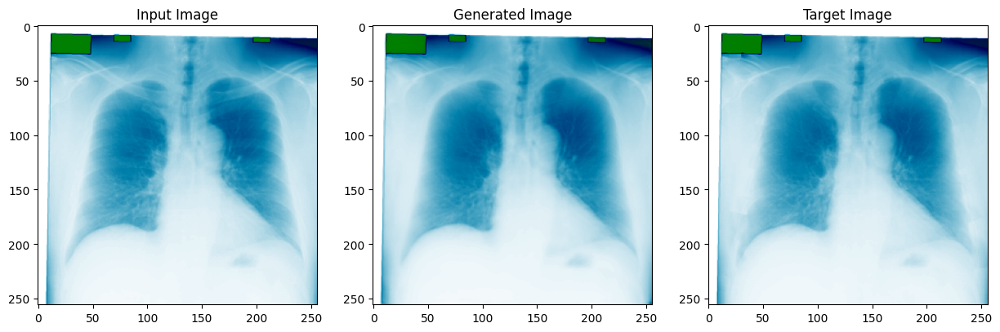

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 42/64
  Train
	L1 SSIM: 0.0137
  Validation Metrics
	L1 SSIM: 0.0153 | MS SSIM: 0.9923 | SSIM: 0.9835 |
	MSE: 0.0003 | MAE: 0.0088 | PSNR: 35.2580 |
LR: 9.999359416037412e-05


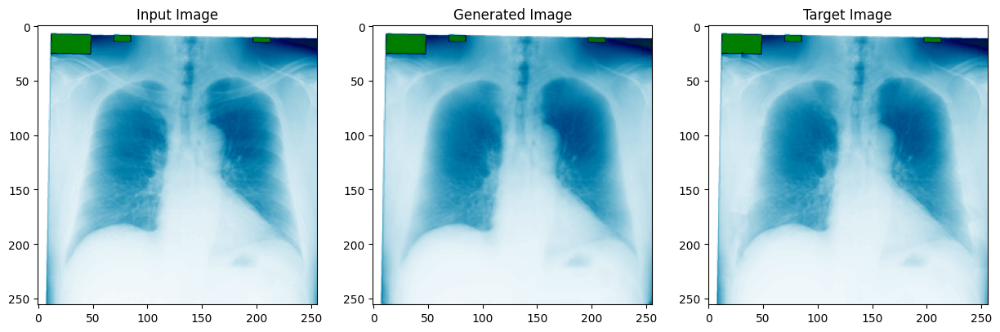

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 43/64
  Train
	L1 SSIM: 0.0142
  Validation Metrics
	L1 SSIM: 0.0206 | MS SSIM: 0.9908 | SSIM: 0.9778 |
	MSE: 0.0005 | MAE: 0.0123 | PSNR: 33.7529 |
LR: 9.999343793063581e-05


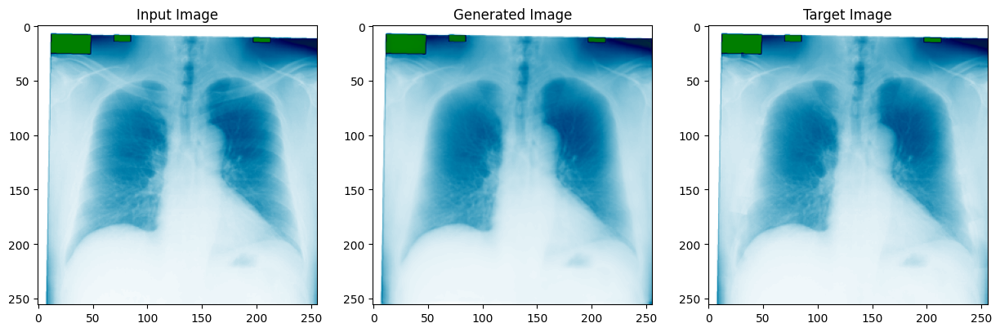

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 44/64
  Train
	L1 SSIM: 0.0140
  Validation Metrics
	L1 SSIM: 0.0148 | MS SSIM: 0.9924 | SSIM: 0.9840 |
	MSE: 0.0003 | MAE: 0.0087 | PSNR: 35.4686 |
LR: 9.999328170138569e-05


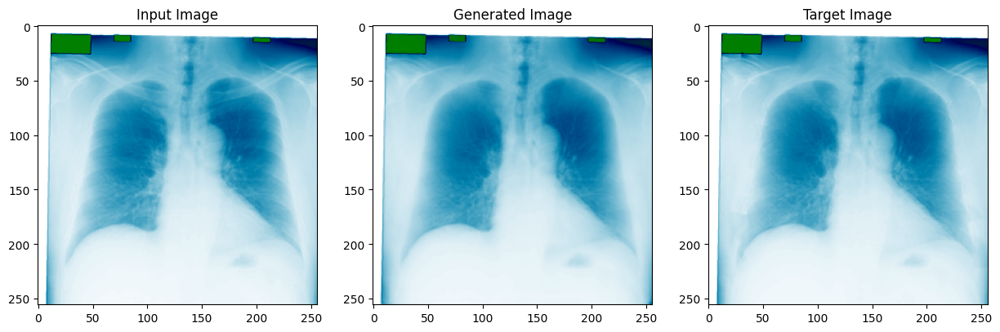

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 45/64
  Train
	L1 SSIM: 0.0131
  Validation Metrics
	L1 SSIM: 0.0141 | MS SSIM: 0.9927 | SSIM: 0.9848 |
	MSE: 0.0003 | MAE: 0.0084 | PSNR: 35.5751 |
LR: 9.999312547262376e-05


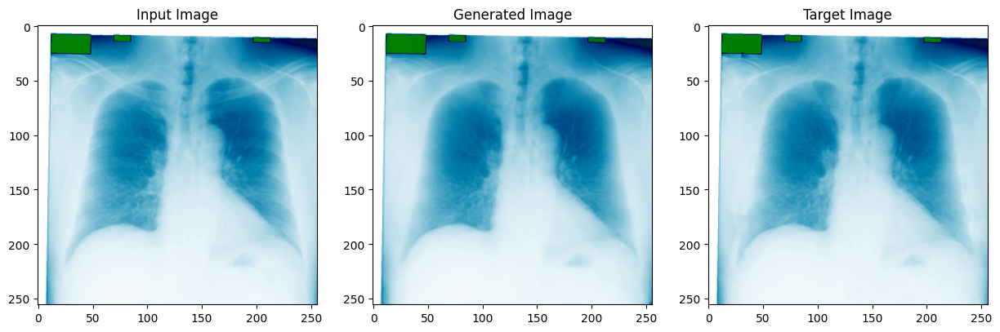

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 46/64
  Train
	L1 SSIM: 0.0127
  Validation Metrics
	L1 SSIM: 0.0144 | MS SSIM: 0.9926 | SSIM: 0.9845 |
	MSE: 0.0003 | MAE: 0.0088 | PSNR: 35.4746 |
LR: 9.999296924435002e-05


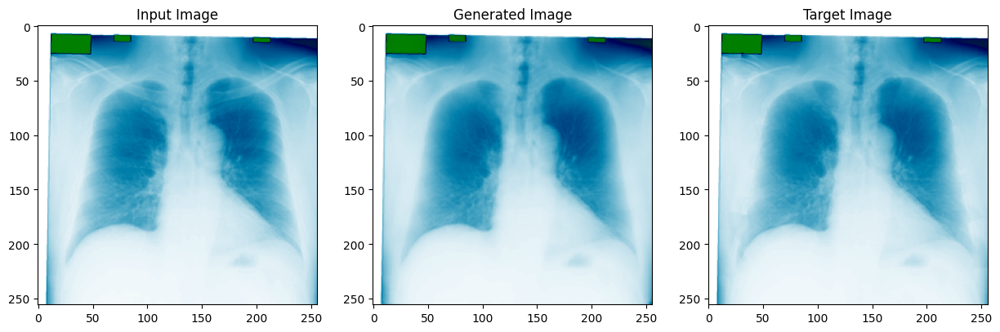

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 47/64
  Train
	L1 SSIM: 0.0130
  Validation Metrics
	L1 SSIM: 0.0148 | MS SSIM: 0.9927 | SSIM: 0.9842 |
	MSE: 0.0003 | MAE: 0.0093 | PSNR: 35.2085 |
LR: 9.999281301656445e-05


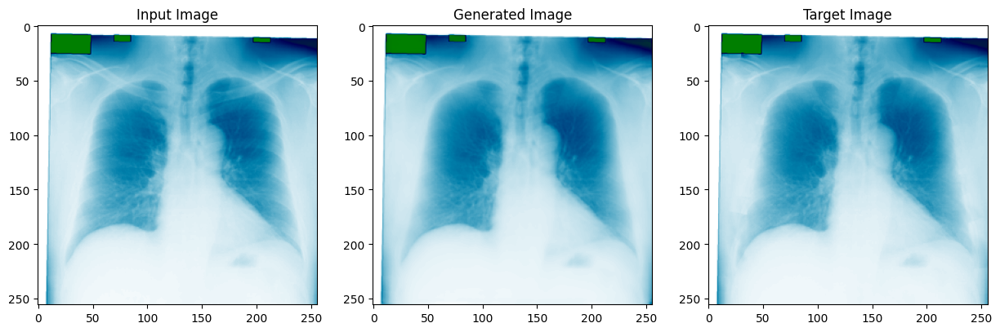

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 48/64
  Train
	L1 SSIM: 0.0132
  Validation Metrics
	L1 SSIM: 0.0196 | MS SSIM: 0.9910 | SSIM: 0.9795 |
	MSE: 0.0006 | MAE: 0.0147 | PSNR: 32.7810 |
LR: 9.999265678926704e-05


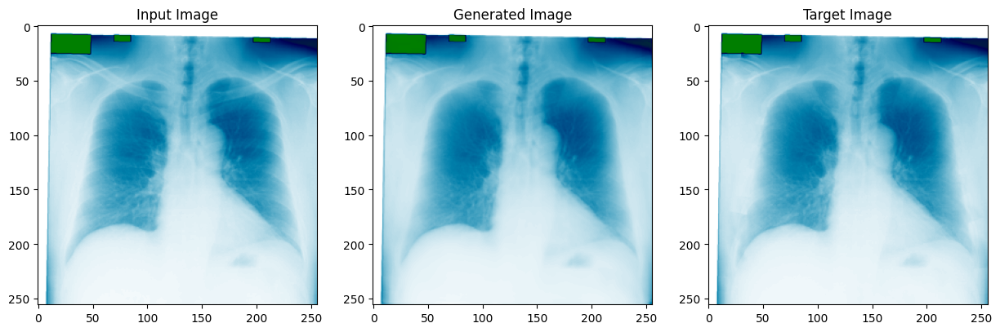

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 49/64
  Train
	L1 SSIM: 0.0142
  Validation Metrics
	L1 SSIM: 0.0135 | MS SSIM: 0.9930 | SSIM: 0.9853 |
	MSE: 0.0003 | MAE: 0.0075 | PSNR: 36.0596 |
LR: 9.999250056245782e-05


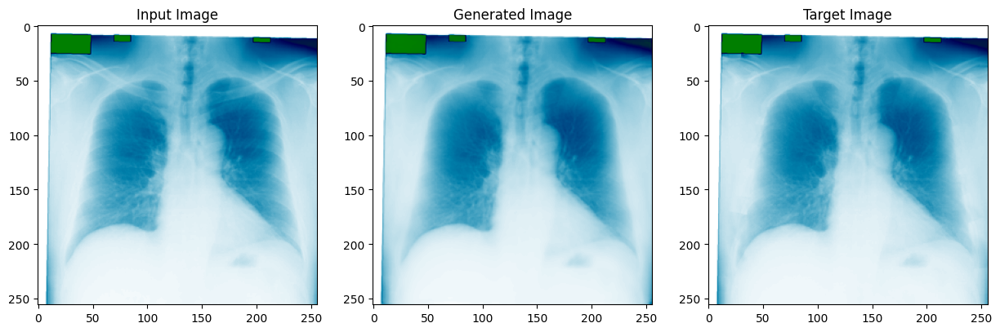

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 50/64
  Train
	L1 SSIM: 0.0121
  Validation Metrics
	L1 SSIM: 0.0133 | MS SSIM: 0.9932 | SSIM: 0.9856 |
	MSE: 0.0003 | MAE: 0.0074 | PSNR: 36.2819 |
LR: 9.999234433613675e-05


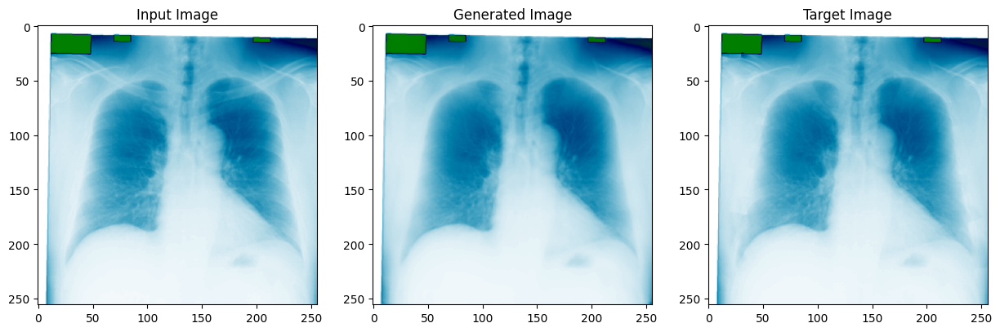

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 51/64
  Train
	L1 SSIM: 0.0118
  Validation Metrics
	L1 SSIM: 0.0132 | MS SSIM: 0.9933 | SSIM: 0.9857 |
	MSE: 0.0003 | MAE: 0.0076 | PSNR: 36.2088 |
LR: 9.999218811030389e-05


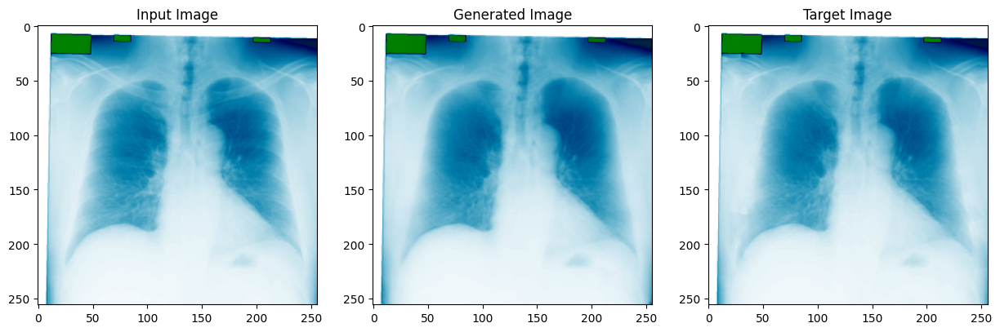

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 52/64
  Train
	L1 SSIM: 0.0118
  Validation Metrics
	L1 SSIM: 0.0130 | MS SSIM: 0.9934 | SSIM: 0.9859 |
	MSE: 0.0003 | MAE: 0.0071 | PSNR: 36.5854 |
LR: 9.999203188495916e-05


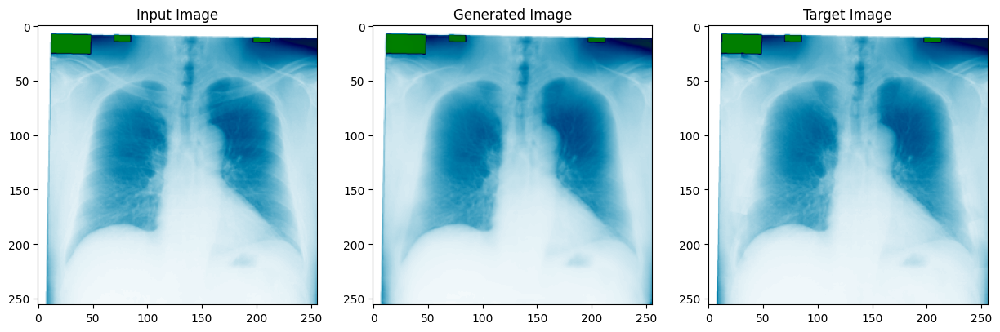

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 53/64
  Train
	L1 SSIM: 0.0116
  Validation Metrics
	L1 SSIM: 0.0131 | MS SSIM: 0.9934 | SSIM: 0.9858 |
	MSE: 0.0003 | MAE: 0.0073 | PSNR: 36.3787 |
LR: 9.999187566010261e-05


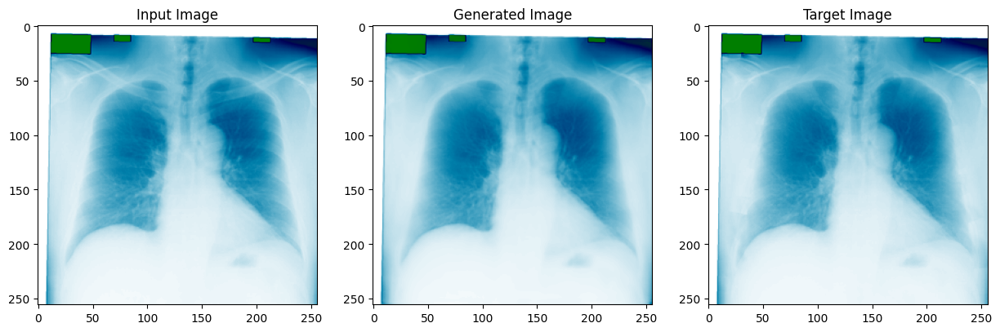

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 54/64
  Train
	L1 SSIM: 0.0117
  Validation Metrics
	L1 SSIM: 0.0131 | MS SSIM: 0.9933 | SSIM: 0.9858 |
	MSE: 0.0003 | MAE: 0.0075 | PSNR: 36.3530 |
LR: 9.999171943573422e-05


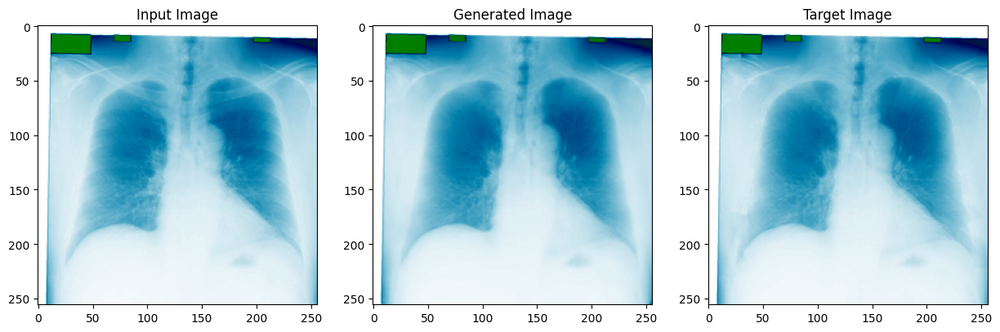

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 55/64
  Train
	L1 SSIM: 0.0135
  Validation Metrics
	L1 SSIM: 0.0143 | MS SSIM: 0.9930 | SSIM: 0.9845 |
	MSE: 0.0003 | MAE: 0.0083 | PSNR: 35.9098 |
LR: 9.999156321185401e-05


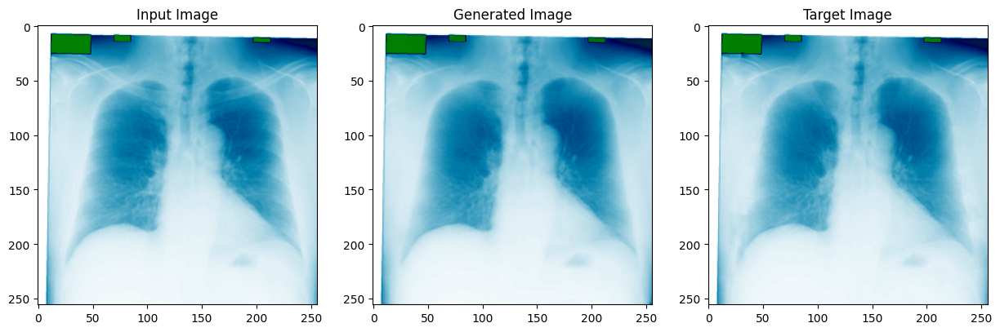

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 56/64
  Train
	L1 SSIM: 0.0114
  Validation Metrics
	L1 SSIM: 0.0127 | MS SSIM: 0.9937 | SSIM: 0.9862 |
	MSE: 0.0002 | MAE: 0.0069 | PSNR: 36.7285 |
LR: 9.999140698846193e-05


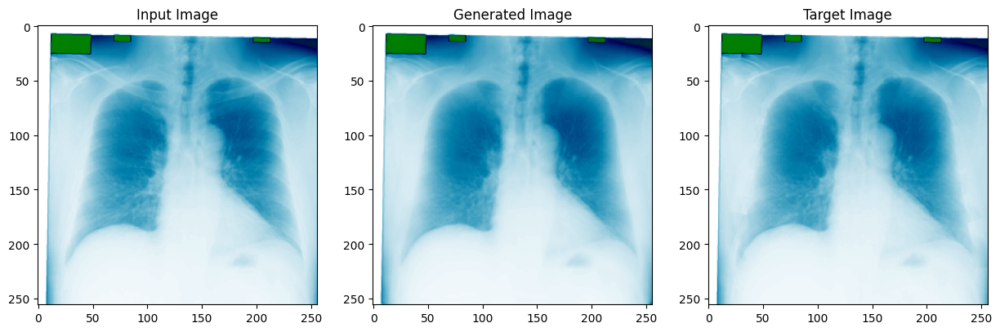

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 57/64
  Train
	L1 SSIM: 0.0110
  Validation Metrics
	L1 SSIM: 0.0124 | MS SSIM: 0.9938 | SSIM: 0.9866 |
	MSE: 0.0002 | MAE: 0.0067 | PSNR: 36.8104 |
LR: 9.999125076555802e-05


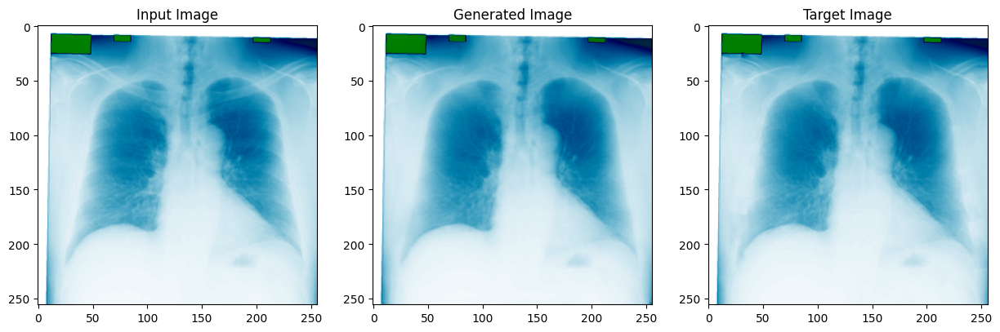

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 58/64
  Train
	L1 SSIM: 0.0110
  Validation Metrics
	L1 SSIM: 0.0123 | MS SSIM: 0.9938 | SSIM: 0.9866 |
	MSE: 0.0002 | MAE: 0.0066 | PSNR: 36.9078 |
LR: 9.999109454314225e-05


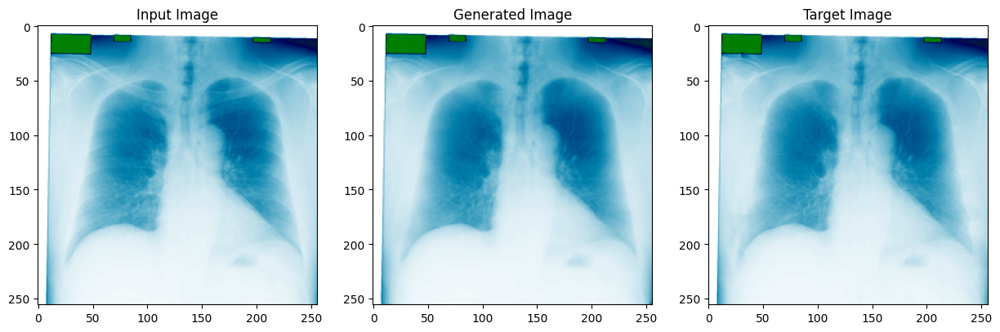

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 59/64
  Train
	L1 SSIM: 0.0110
  Validation Metrics
	L1 SSIM: 0.0125 | MS SSIM: 0.9938 | SSIM: 0.9864 |
	MSE: 0.0002 | MAE: 0.0068 | PSNR: 36.7936 |
LR: 9.999093832121466e-05


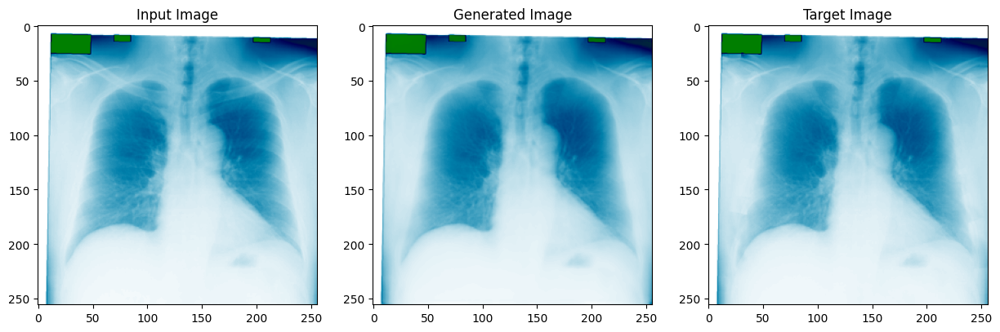

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 60/64
  Train
	L1 SSIM: 0.0109
  Validation Metrics
	L1 SSIM: 0.0125 | MS SSIM: 0.9938 | SSIM: 0.9864 |
	MSE: 0.0002 | MAE: 0.0068 | PSNR: 36.7853 |
LR: 9.999078209977518e-05


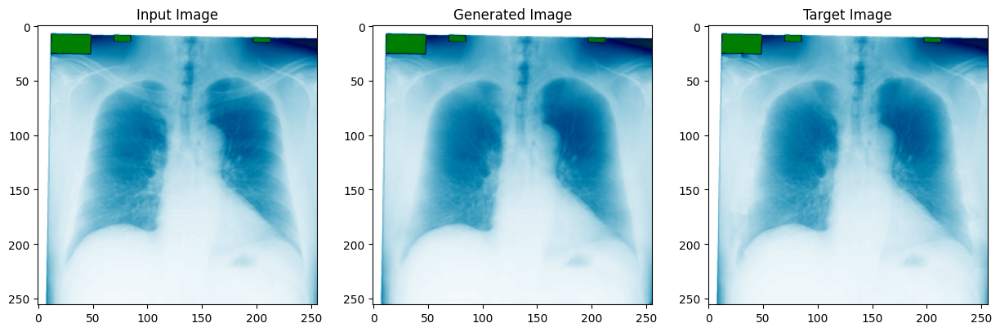

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 61/64
  Train
	L1 SSIM: 0.0134
  Validation Metrics
	L1 SSIM: 0.0163 | MS SSIM: 0.9922 | SSIM: 0.9825 |
	MSE: 0.0004 | MAE: 0.0103 | PSNR: 34.8724 |
LR: 9.999062587882386e-05


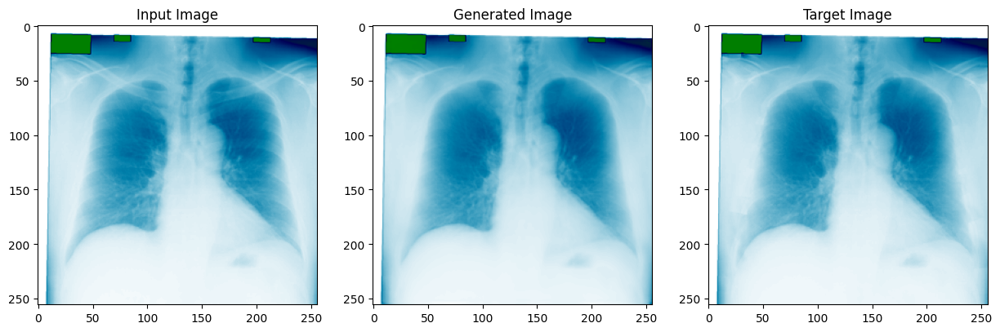

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 62/64
  Train
	L1 SSIM: 0.0113
  Validation Metrics
	L1 SSIM: 0.0121 | MS SSIM: 0.9940 | SSIM: 0.9869 |
	MSE: 0.0002 | MAE: 0.0071 | PSNR: 36.8987 |
LR: 9.999046965836069e-05


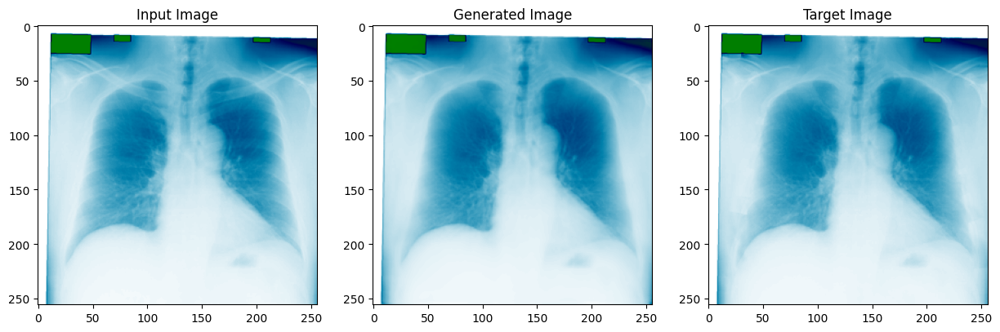

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 63/64
  Train
	L1 SSIM: 0.0105
  Validation Metrics
	L1 SSIM: 0.0118 | MS SSIM: 0.9942 | SSIM: 0.9872 |
	MSE: 0.0002 | MAE: 0.0063 | PSNR: 37.3045 |
LR: 9.999031343838565e-05


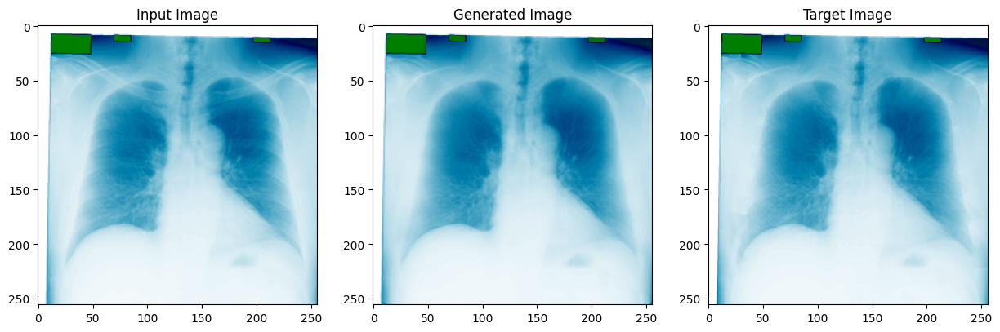

  0%|          | 0/408 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

Epoch 64/64
  Train
	L1 SSIM: 0.0104
  Validation Metrics
	L1 SSIM: 0.0117 | MS SSIM: 0.9942 | SSIM: 0.9873 |
	MSE: 0.0002 | MAE: 0.0062 | PSNR: 37.3333 |
LR: 9.999015721889877e-05


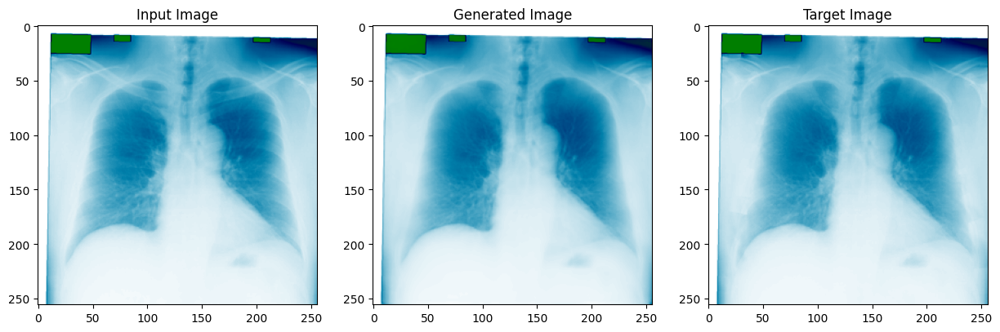

In [17]:
train_model(model, train_loader, val_loader, test_loader, optimizer, device, epochs=epochs, decay=decay)

In [18]:
checkpoint = torch.load("best_checkpoint.pt")
model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
print(f"Restored best model from epoch {early_stopper.epoch+1} with val_loss={early_stopper.min_loss:.4f}")

Restored best model from epoch 64 with val_loss=0.0117


<ipython-input-18-f2574e6fcef1>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load("best_checkpoint.pt")


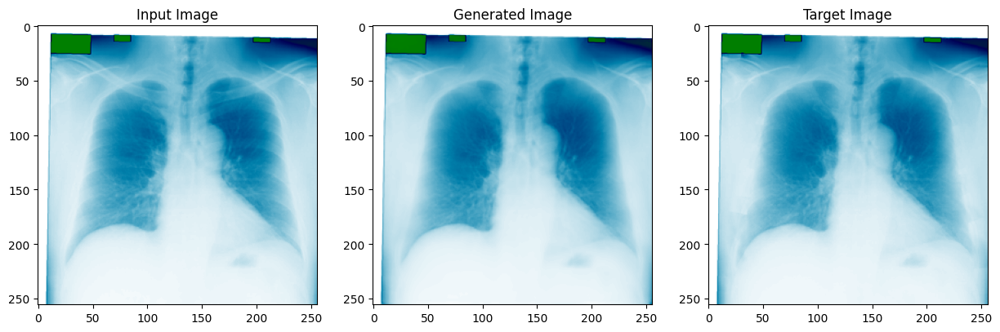

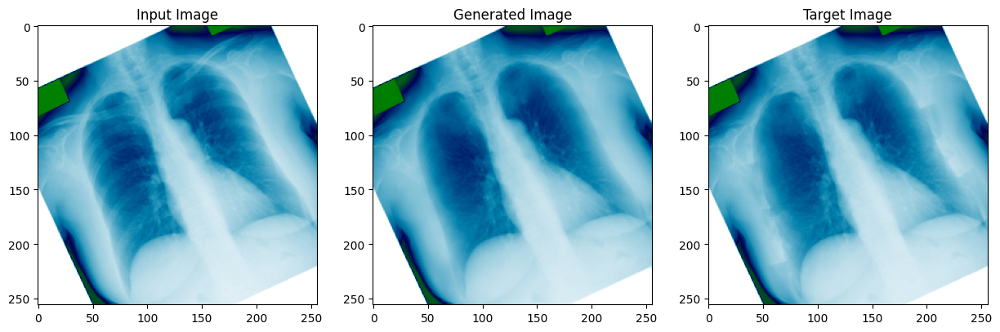

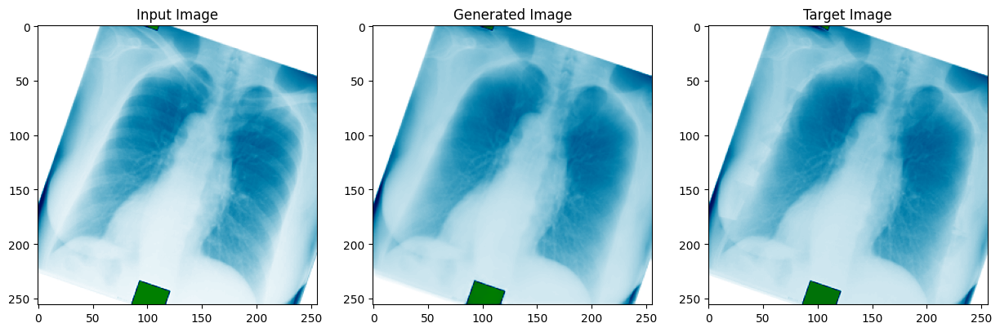

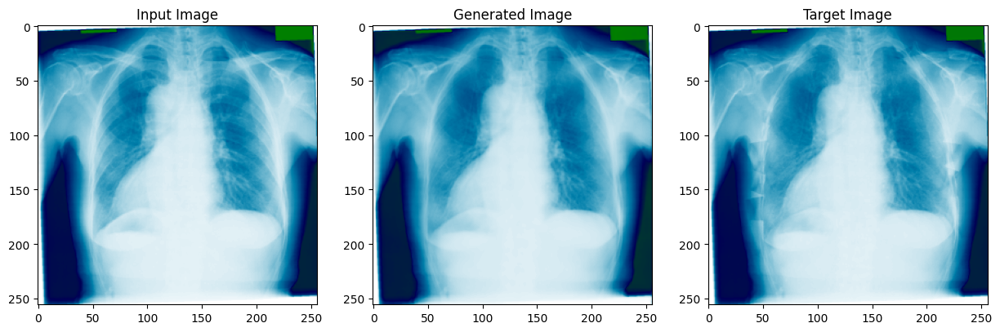

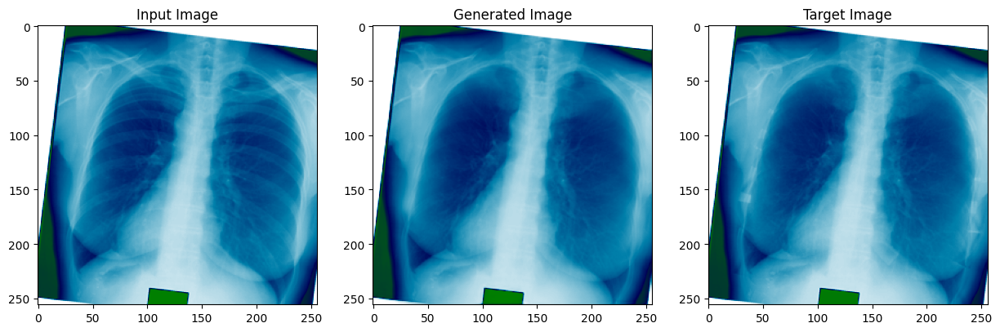

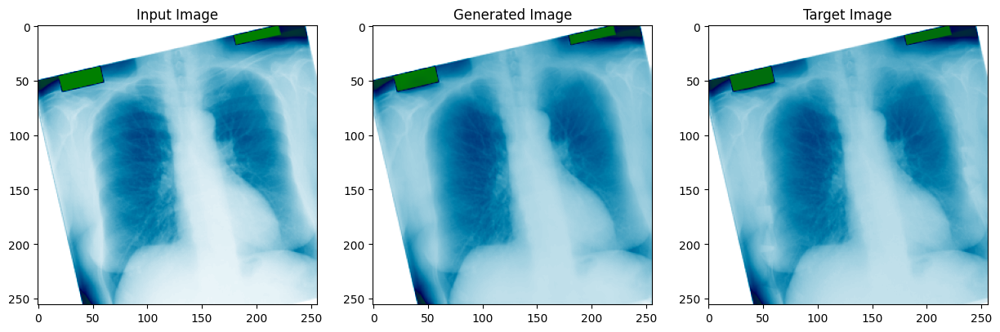

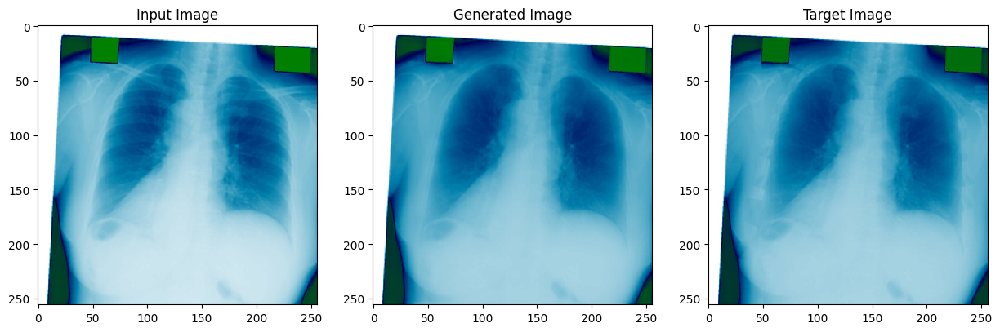

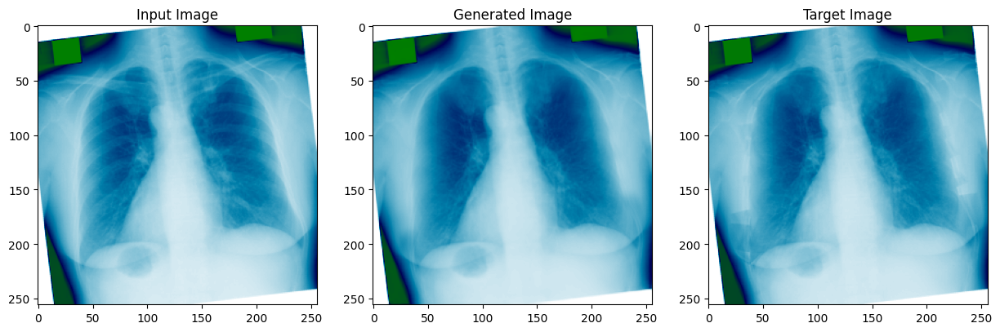

In [19]:
visualize_example(test_loader, model, device, full_batch=True)

In [20]:
test_metrics = evaluate(test_loader, model, device)
display_metrics(test_metrics, data_subset="Test")

  0%|          | 0/26 [00:00<?, ?it/s]

  Test Metrics
	L1 SSIM: 0.0119 | MS SSIM: 0.9941 | SSIM: 0.9870 |
	MSE: 0.0002 | MAE: 0.0061 | PSNR: 37.4026 |


In [21]:
torch.save(model.state_dict(), 'xU-NetFullSharp.pth')